# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [2]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [3]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [4]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [19]:
n_epochs = 30
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [6]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [7]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [8]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [9]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = torch.mean((gradient_norm - 1) ** 2)
    #### END CODE HERE ####
    return penalty

In [10]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [13]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = - crit_fake_pred.mean()
    #### END CODE HERE ####
    return gen_loss

In [14]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [17]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = crit_fake_pred.mean() - crit_real_pred.mean() + (c_lambda * gp)
    #### END CODE HERE ####
    return crit_loss

In [18]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: -0.09181828417349606, critic loss: 1.8955977317541834


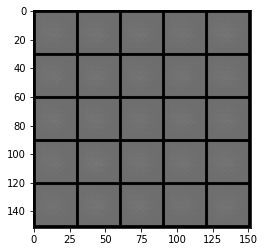

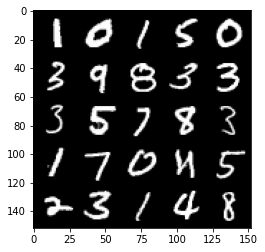

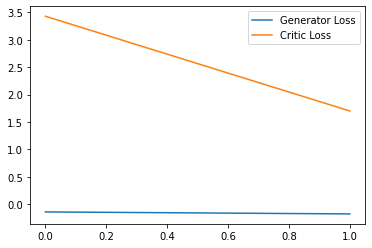

Step 100: Generator loss: 0.8111922244355082, critic loss: -1.7422589377462865


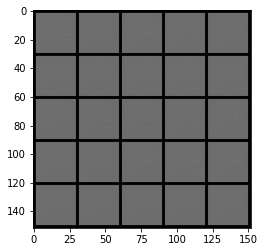

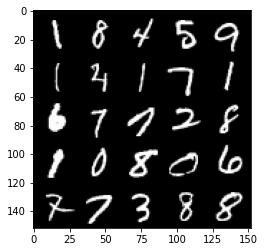

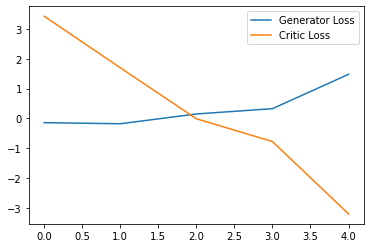

Step 150: Generator loss: 2.544583501815796, critic loss: -10.69899850845337


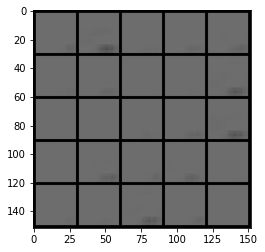

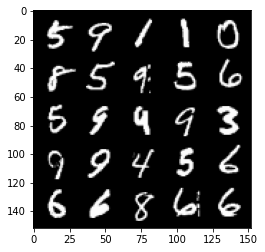

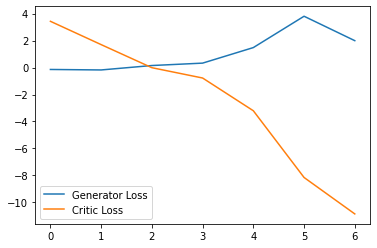

Step 200: Generator loss: -0.5422923211753369, critic loss: -25.96719831466674


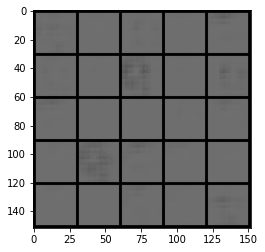

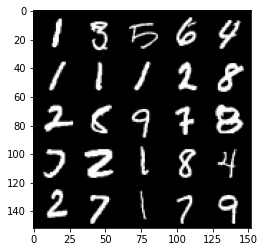

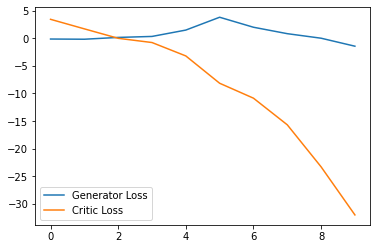

Step 250: Generator loss: -2.305164543390274, critic loss: -54.862991500854505


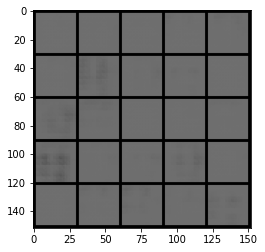

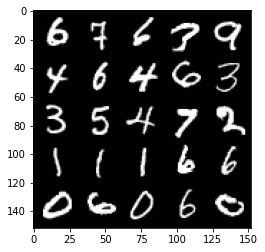

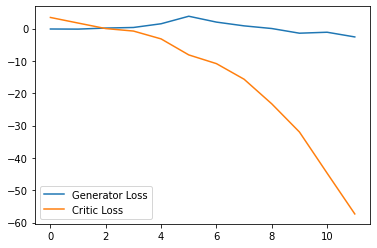

Step 300: Generator loss: -3.5456193256378175, critic loss: -90.99637748718264


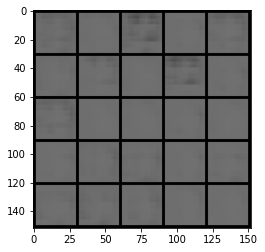

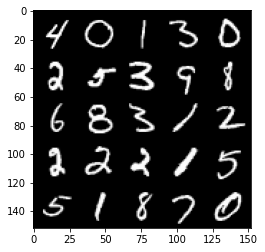

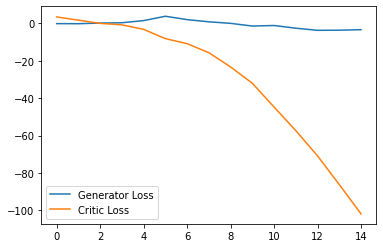

Step 350: Generator loss: -3.011168823838234, critic loss: -131.29913464355468


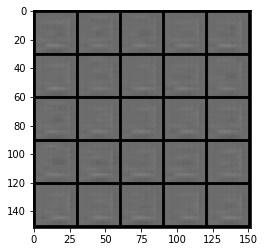

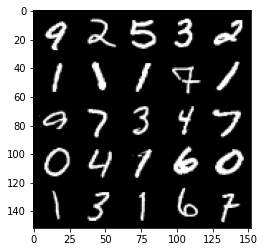

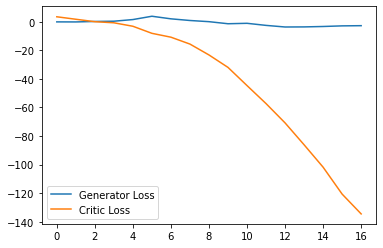

Step 400: Generator loss: -0.40820111505687234, critic loss: -169.0758433227539


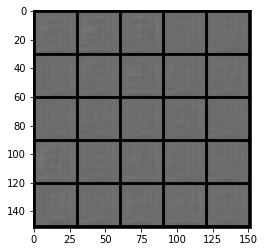

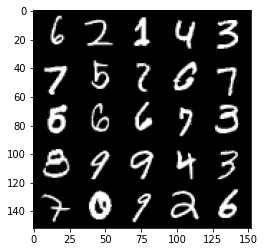

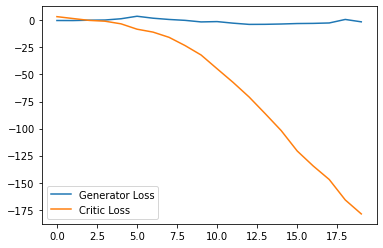

Step 450: Generator loss: 4.149645252227783, critic loss: -215.41180712890625


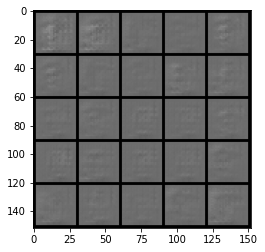

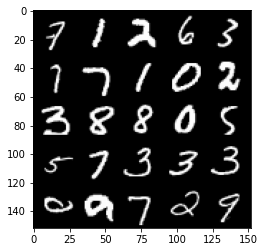

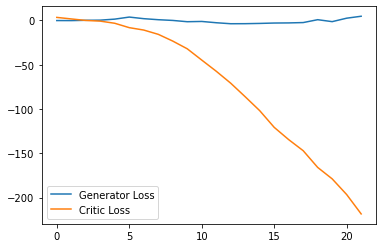

Step 500: Generator loss: 7.451640844345093, critic loss: -266.6132811279297


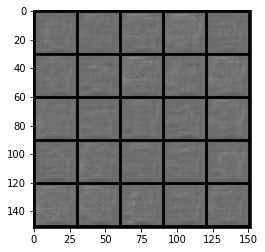

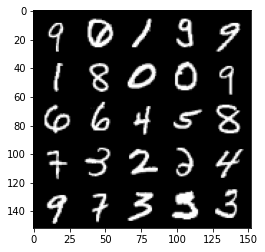

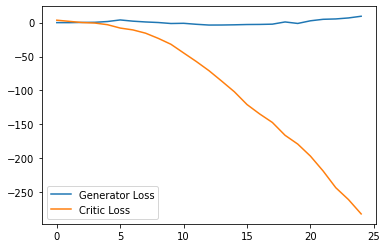

Step 550: Generator loss: 13.264861621856689, critic loss: -311.5477473754883


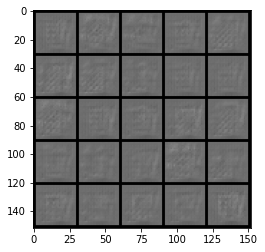

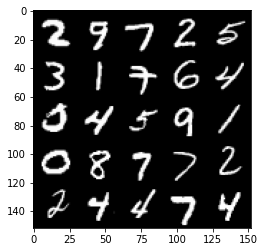

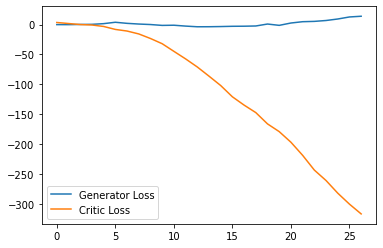

Step 600: Generator loss: 18.124901866912843, critic loss: -364.13130651855477


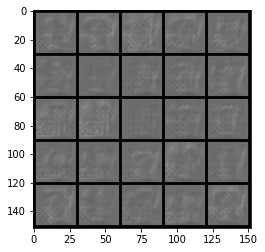

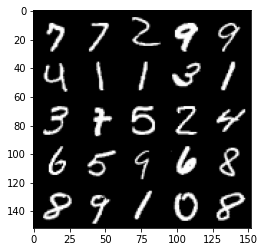

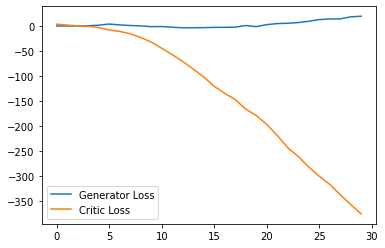

Step 650: Generator loss: 19.621585845947266, critic loss: -394.6159279174805


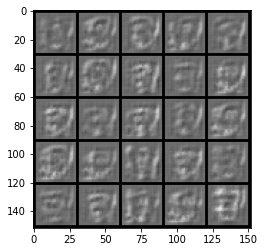

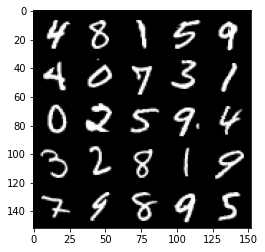

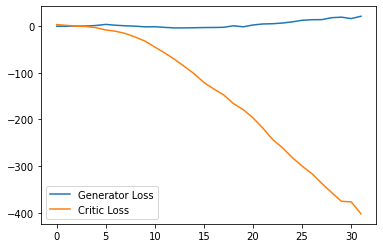

Step 700: Generator loss: -11.482316467761994, critic loss: -323.0439808654785


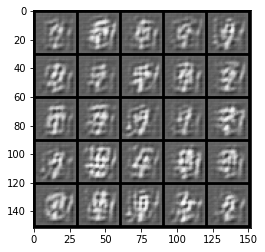

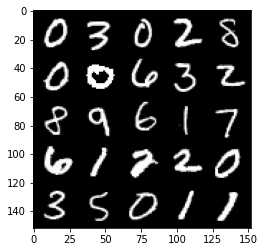

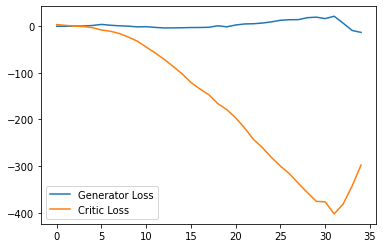

Step 750: Generator loss: -33.0645461833477, critic loss: -262.0664533996581


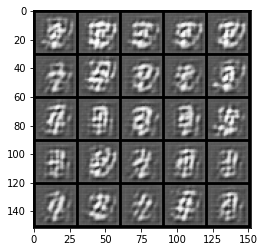

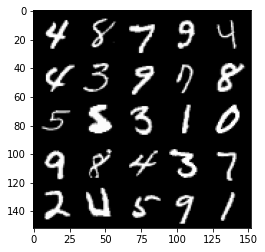

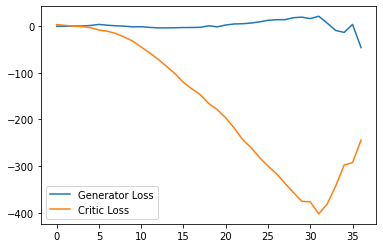

Step 800: Generator loss: -57.37011709690094, critic loss: -206.9207114105224


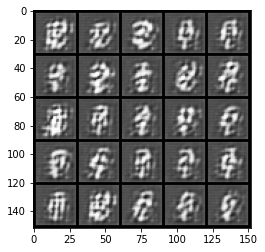

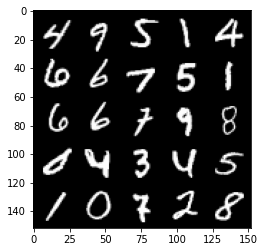

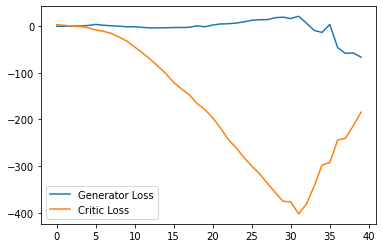

Step 850: Generator loss: -49.544099363088606, critic loss: -169.8758144836426


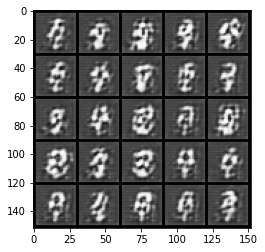

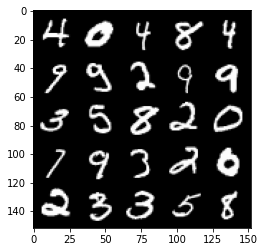

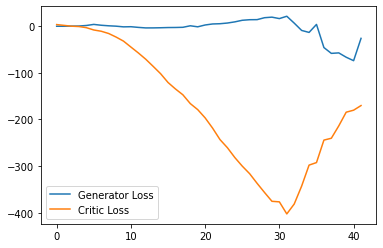

Step 900: Generator loss: -31.811730189323427, critic loss: -112.77217376708982


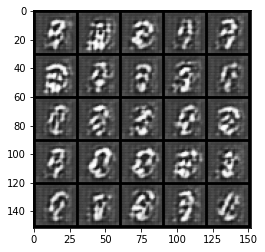

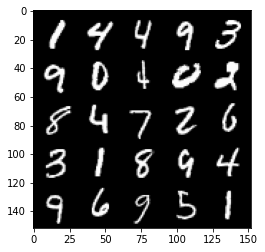

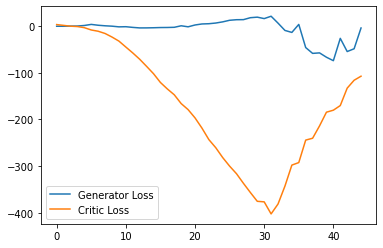

Step 950: Generator loss: -42.628003948926924, critic loss: -128.2764618835449


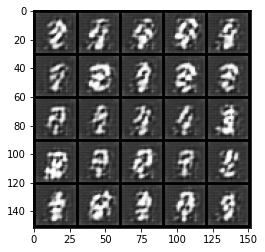

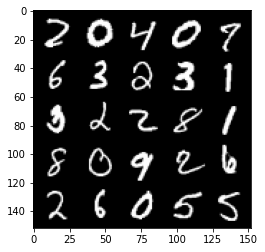

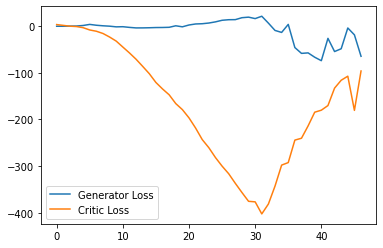

Step 1000: Generator loss: -17.663272588253022, critic loss: -44.07846954345701


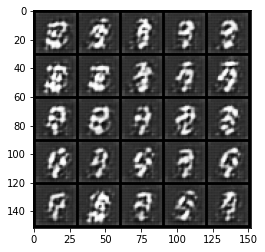

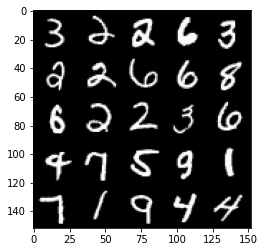

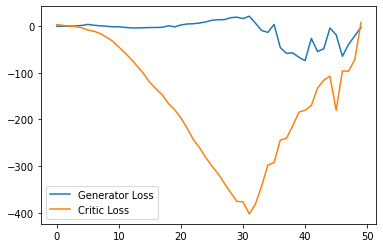

Step 1050: Generator loss: 11.779882431030273, critic loss: 48.55905287170409


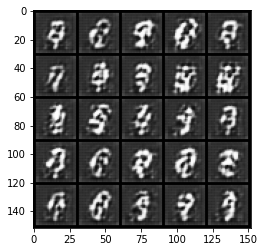

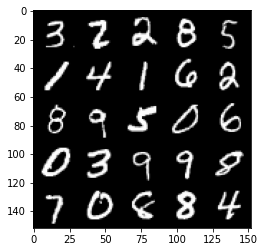

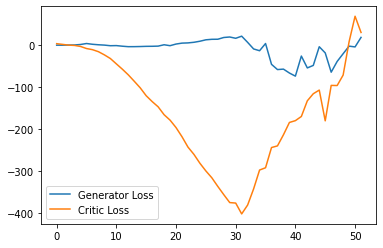

Step 1100: Generator loss: 21.634297409057616, critic loss: 21.604292961120592


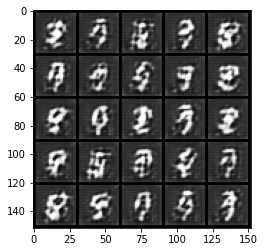

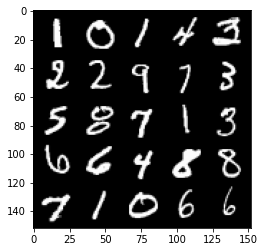

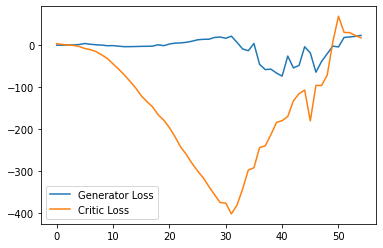

Step 1150: Generator loss: 26.63463134765625, critic loss: 33.63115831756593


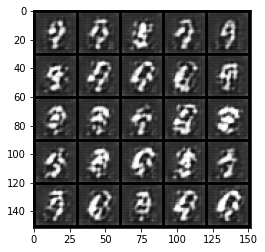

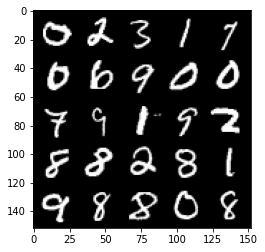

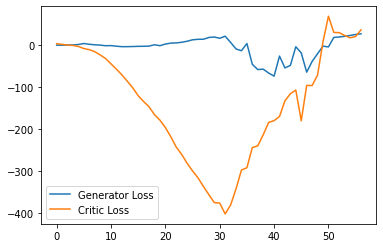

Step 1200: Generator loss: 29.85774055480957, critic loss: 74.30769812011718


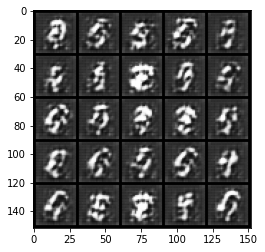

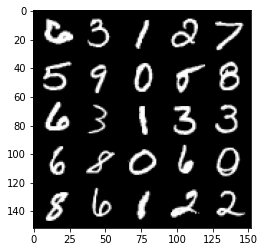

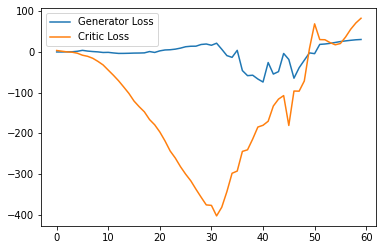

Step 1250: Generator loss: 29.83912651062012, critic loss: 79.72675022888185


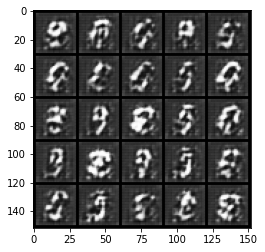

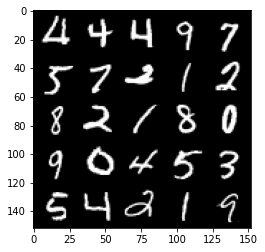

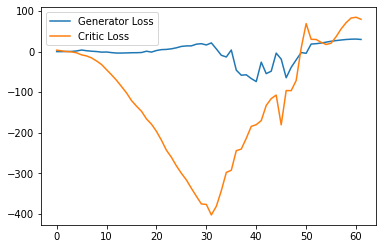

Step 1300: Generator loss: 23.994650497436524, critic loss: 56.27659781646728


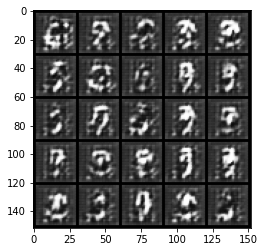

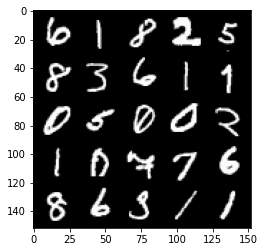

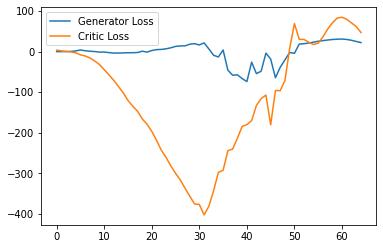

Step 1350: Generator loss: 18.470067863464354, critic loss: 25.689933094024664


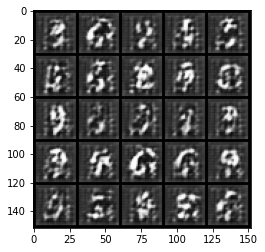

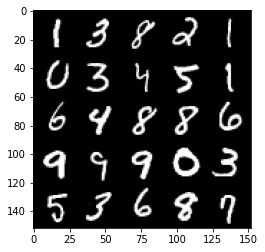

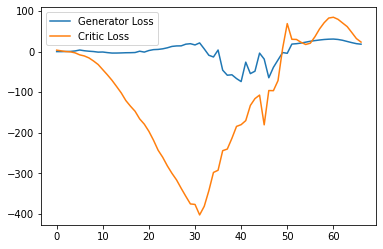

Step 1400: Generator loss: 17.208207206726073, critic loss: 16.911969871521


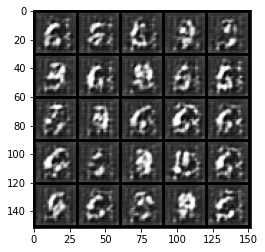

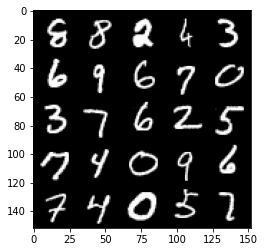

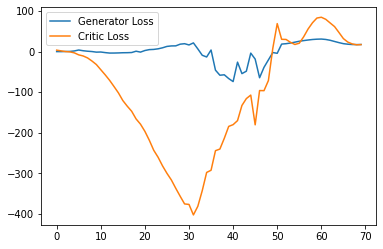

Step 1450: Generator loss: 18.32564743041992, critic loss: 18.199616966247564


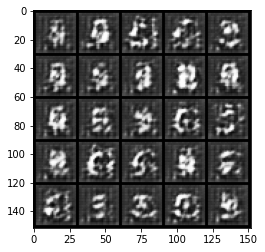

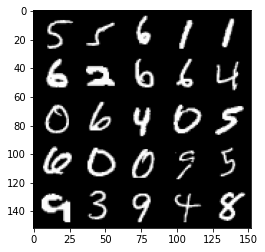

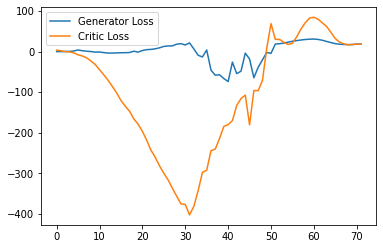

Step 1500: Generator loss: 17.36519229888916, critic loss: 14.41072617721558


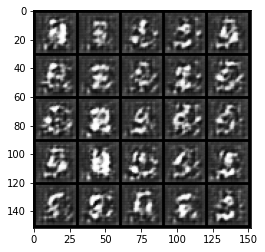

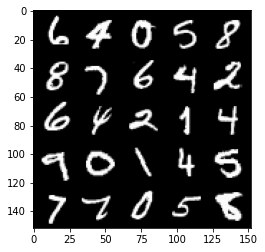

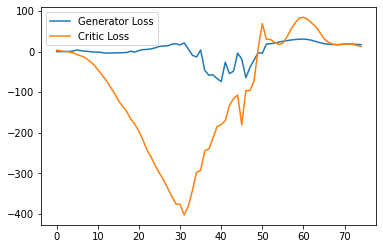

Step 1550: Generator loss: 16.366120834350586, critic loss: 9.043244363784789


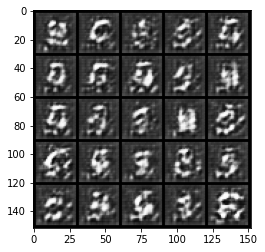

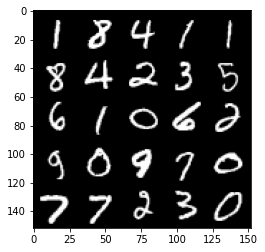

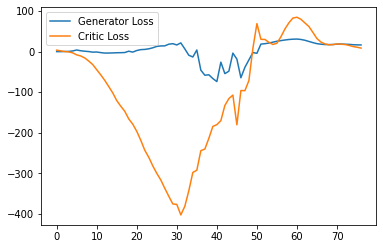

Step 1600: Generator loss: 16.803263549804687, critic loss: 5.144089384078979


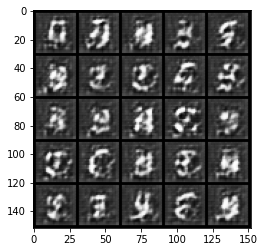

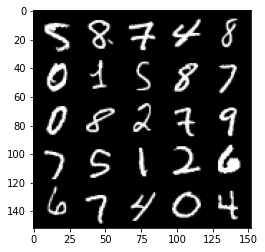

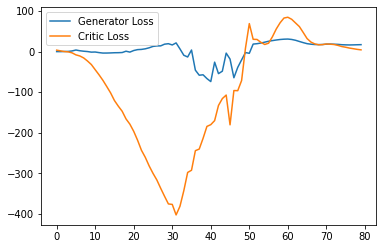

Step 1650: Generator loss: 17.75725444793701, critic loss: 3.0133054981231697


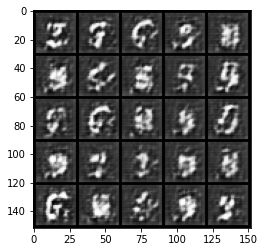

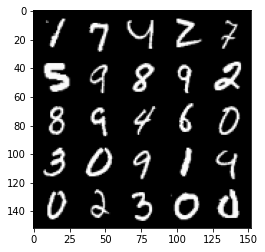

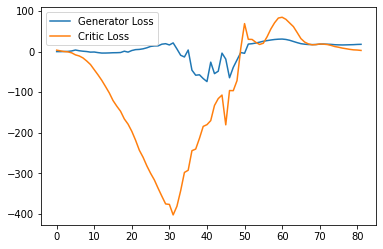

Step 1700: Generator loss: 18.904269943237306, critic loss: 1.2823928518295287


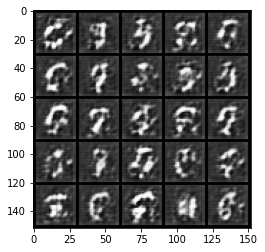

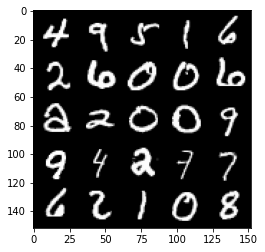

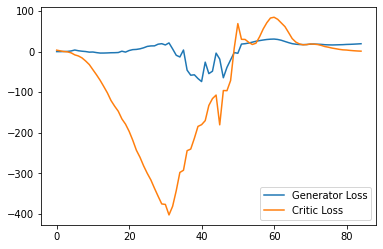

Step 1750: Generator loss: 18.717541885375976, critic loss: 0.6137484536170961


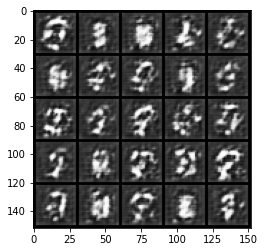

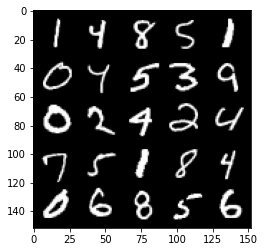

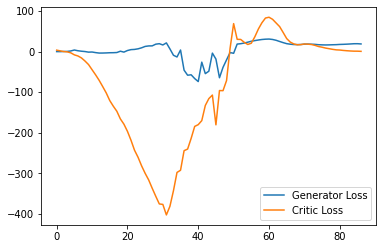

Step 1800: Generator loss: 16.893941783905028, critic loss: 0.1831161499023437


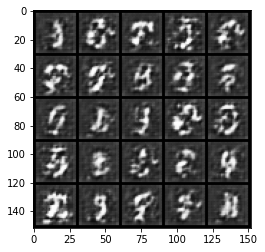

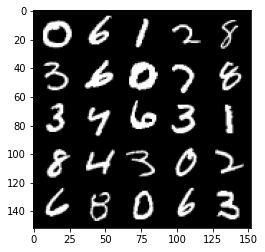

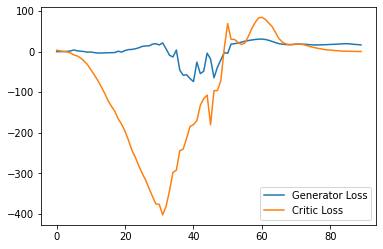

Step 1850: Generator loss: 14.428884716033936, critic loss: -0.831180863380432


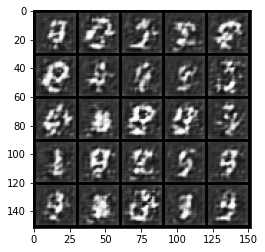

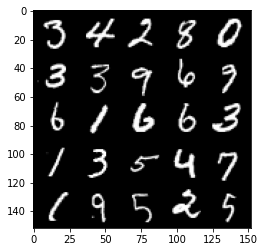

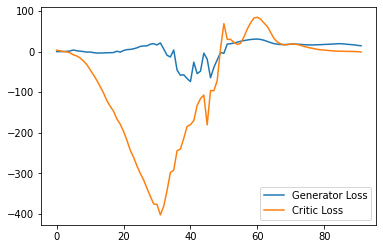

Step 1900: Generator loss: 12.949741821289063, critic loss: -2.040622458934784


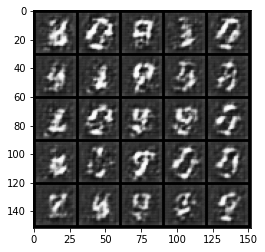

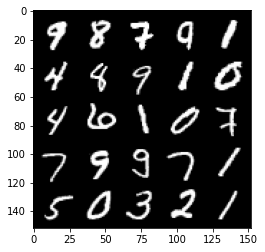

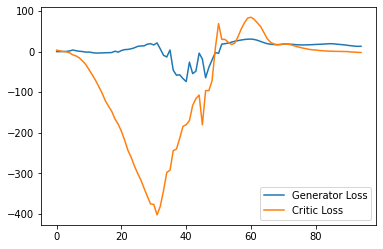

Step 1950: Generator loss: 14.782542819976806, critic loss: -2.937621777534485


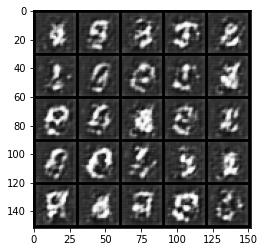

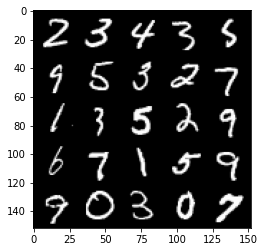

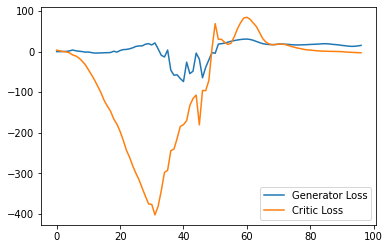

Step 2000: Generator loss: 17.414230003356934, critic loss: -3.3730053281784036


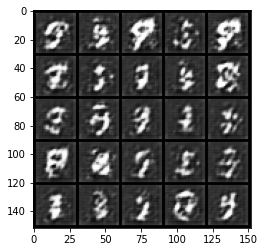

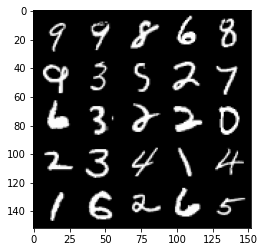

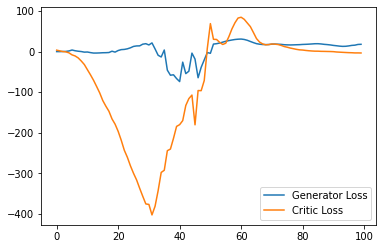

Step 2050: Generator loss: 20.0846178150177, critic loss: -4.997613660812378


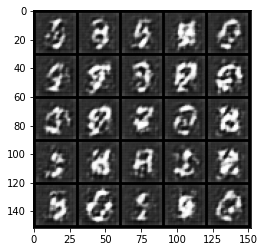

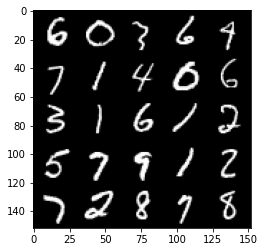

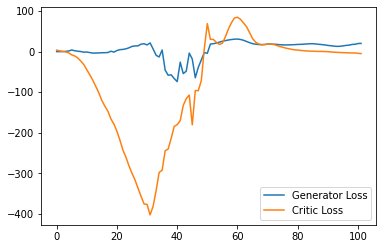

Step 2100: Generator loss: 21.157866020202636, critic loss: -7.863278102874756


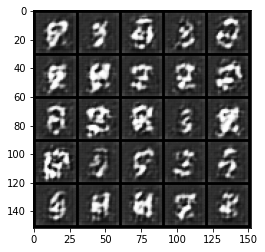

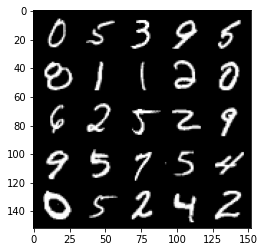

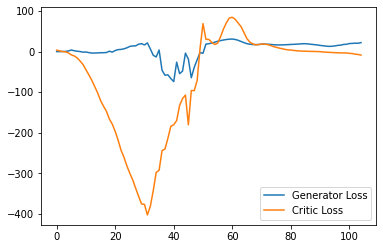

Step 2150: Generator loss: 22.937918701171874, critic loss: -11.410768043518068


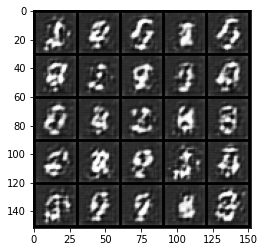

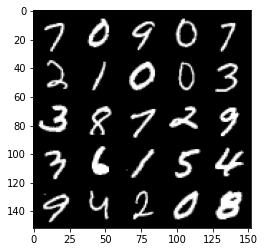

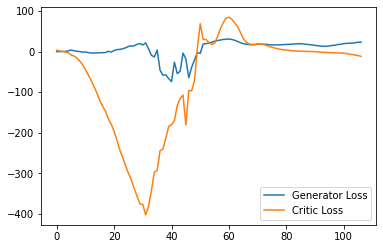

Step 2200: Generator loss: 24.10709274291992, critic loss: -13.876218420028682


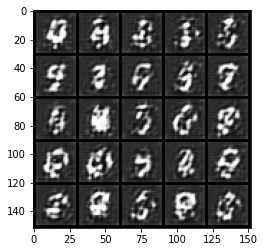

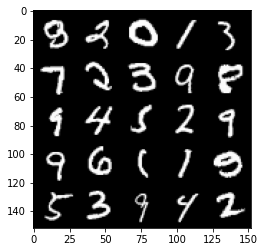

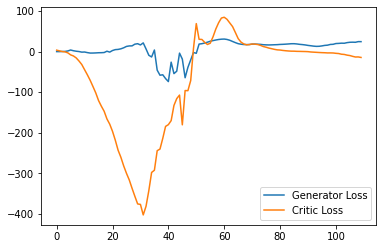

Step 2250: Generator loss: 26.516679935455322, critic loss: -16.26622059631348


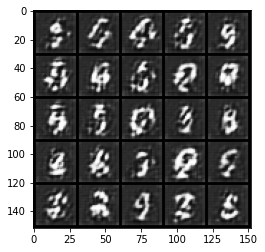

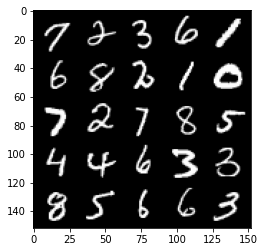

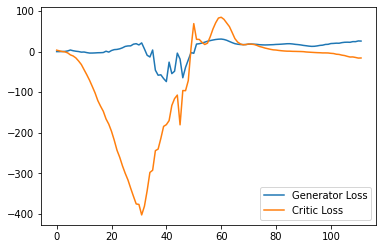

Step 2300: Generator loss: 28.306939315795898, critic loss: -18.01237472915649


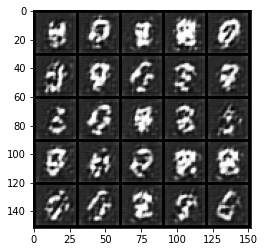

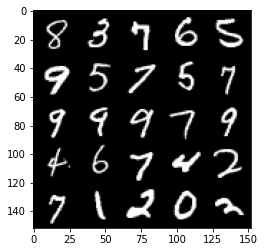

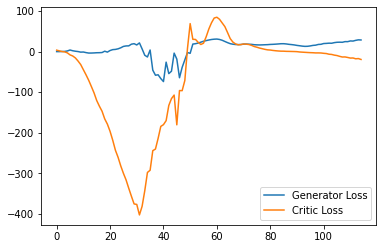

Step 2350: Generator loss: 30.261694068908692, critic loss: -20.11494568824768


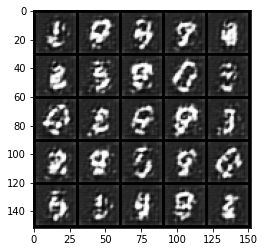

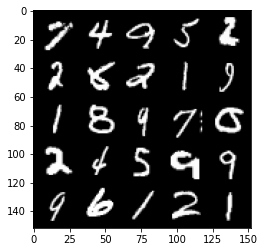

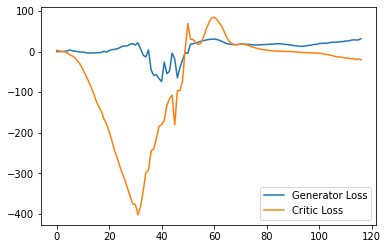

Step 2400: Generator loss: 32.11704635620117, critic loss: -21.939633766174314


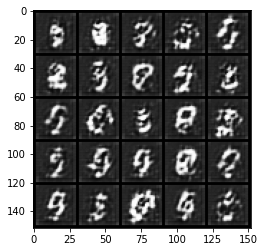

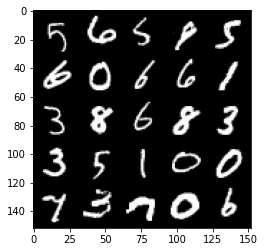

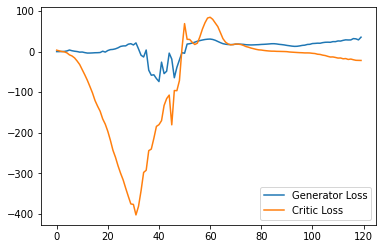

Step 2450: Generator loss: 32.1949295425415, critic loss: -21.806642158508303


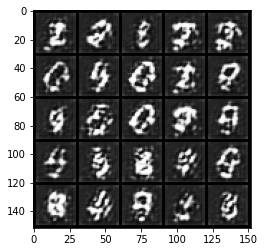

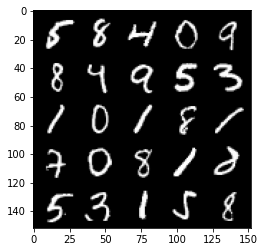

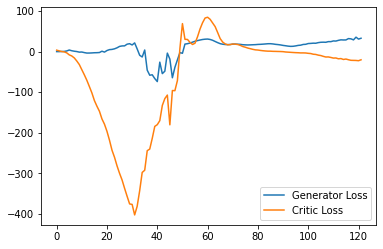

Step 2500: Generator loss: 32.85814098358154, critic loss: -23.575654748916627


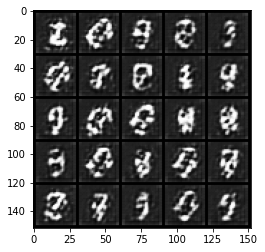

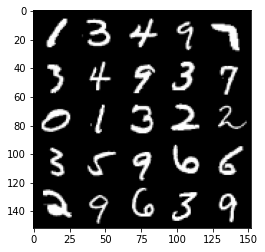

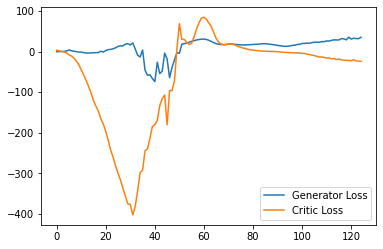

Step 2550: Generator loss: 35.469498825073245, critic loss: -23.170473949432377


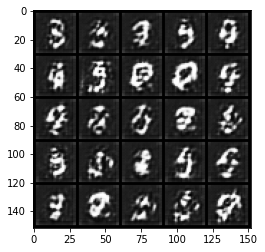

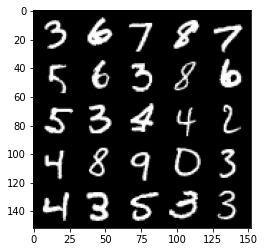

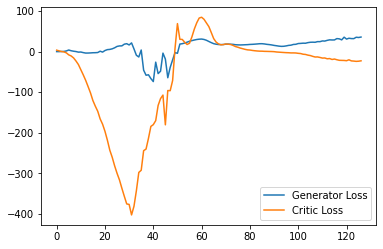

Step 2600: Generator loss: 38.03257049560547, critic loss: -21.65660503578186


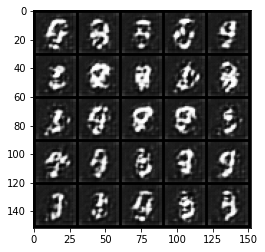

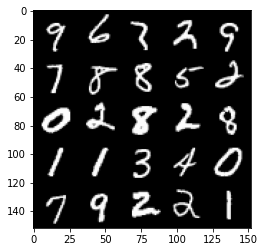

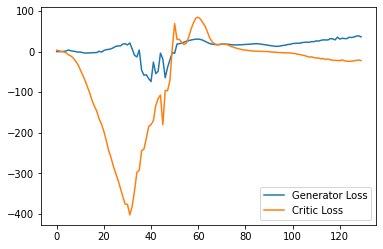

Step 2650: Generator loss: 39.449560737609865, critic loss: -21.277452265739445


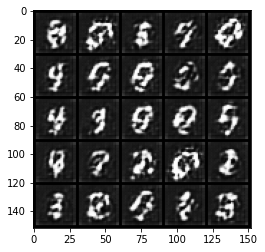

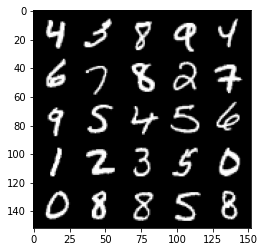

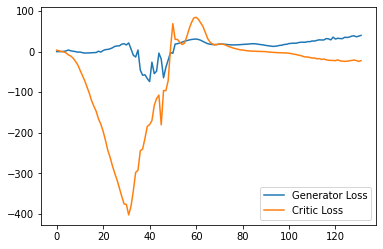

Step 2700: Generator loss: 38.333560104370115, critic loss: -22.31494763183594


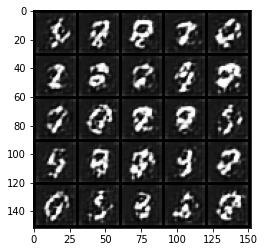

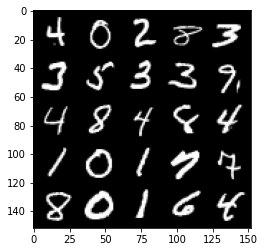

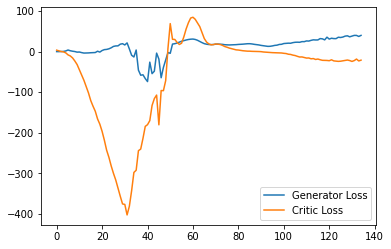

Step 2750: Generator loss: 40.75337951660156, critic loss: -21.152231945037848


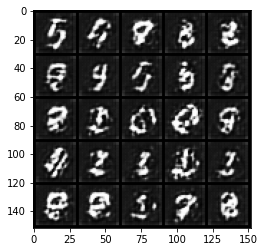

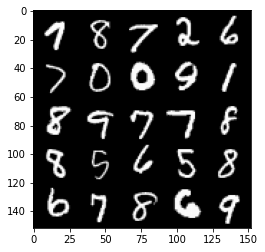

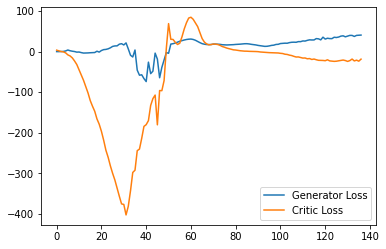

Step 2800: Generator loss: 42.19903392791748, critic loss: -21.52541648864747


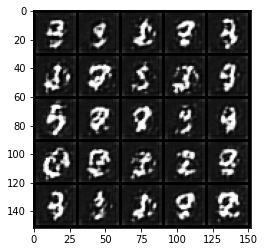

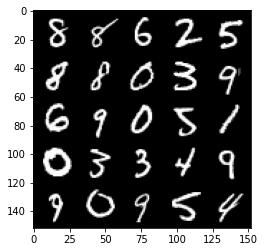

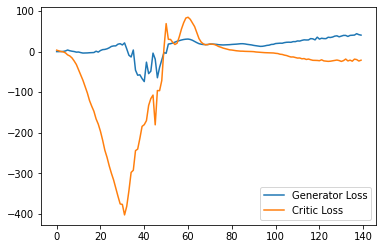

Step 2850: Generator loss: 41.28177207946777, critic loss: -21.167205803871152


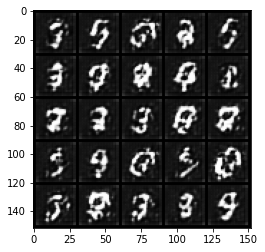

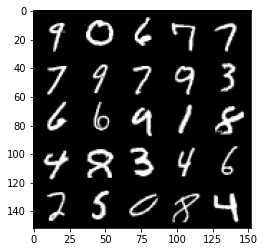

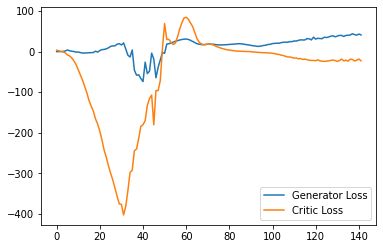

Step 2900: Generator loss: 48.96041152954101, critic loss: -11.472711713790897


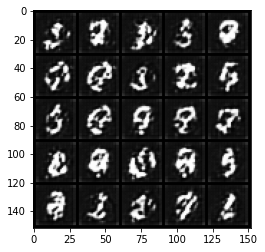

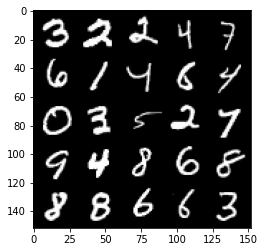

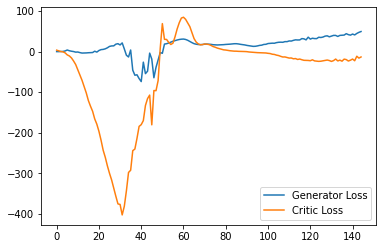

Step 2950: Generator loss: 44.553215179443356, critic loss: -16.990912932395933


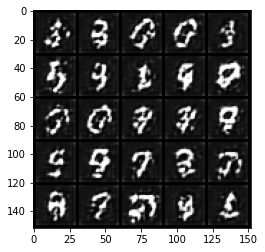

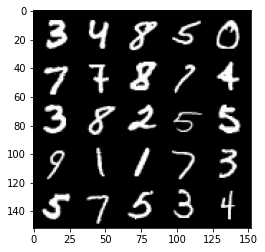

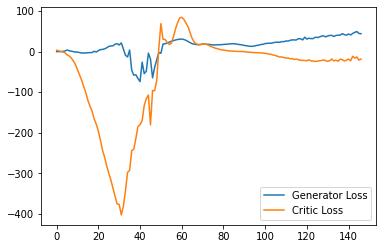

Step 3000: Generator loss: 49.53419715881348, critic loss: -16.79057795238495


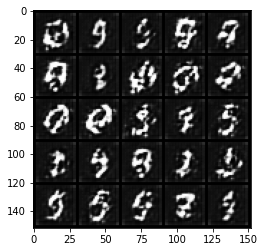

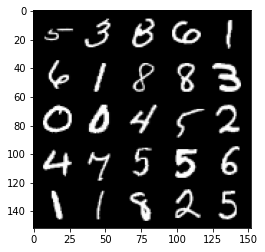

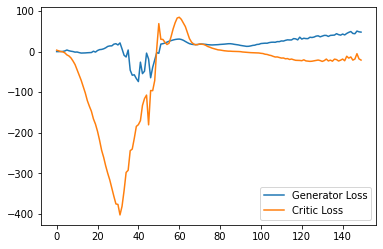

Step 3050: Generator loss: 47.0926927947998, critic loss: -17.197026258468625


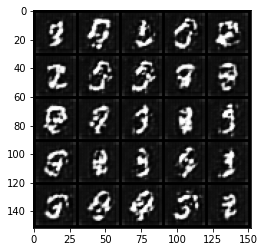

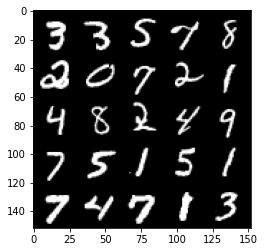

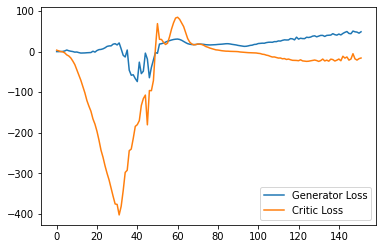

Step 3100: Generator loss: 48.8437459564209, critic loss: -18.36472904205322


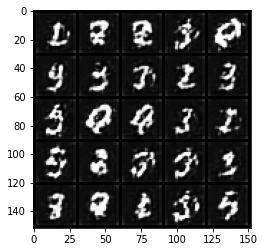

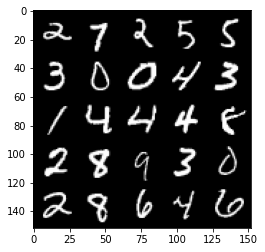

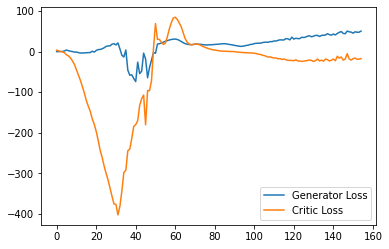

Step 3150: Generator loss: 50.05629722595215, critic loss: -15.81975124645233


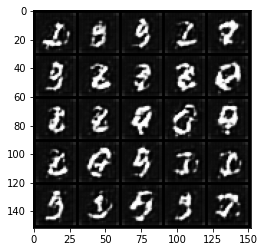

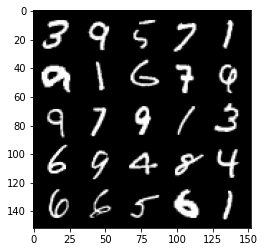

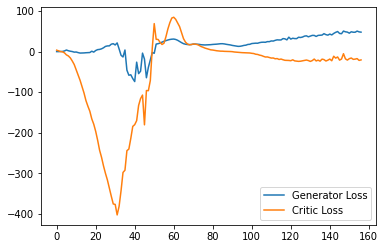

Step 3200: Generator loss: 53.91040580749512, critic loss: -12.90337625980377


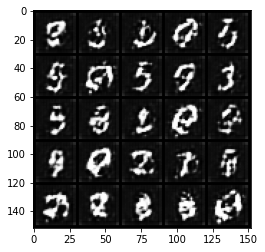

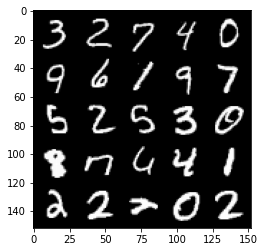

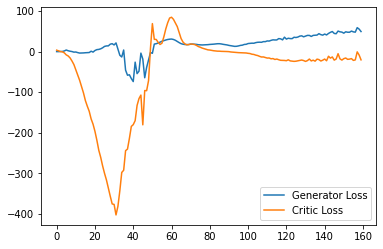

Step 3250: Generator loss: 58.74236167907715, critic loss: -4.348742898941041


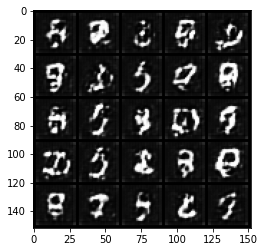

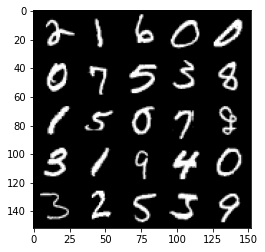

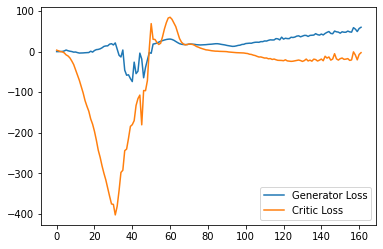

Step 3300: Generator loss: 52.95507751464844, critic loss: -16.216902169227602


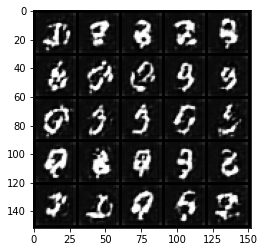

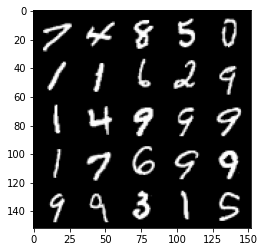

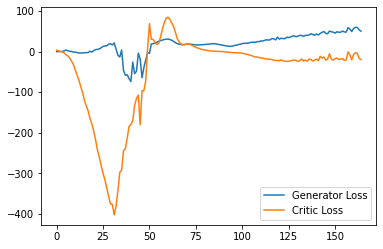

Step 3350: Generator loss: 51.73132438659668, critic loss: -16.823991227149968


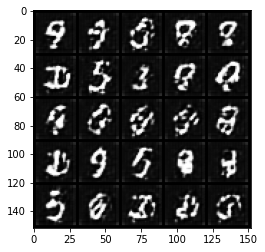

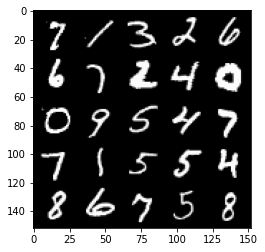

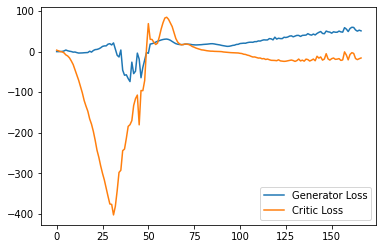

Step 3400: Generator loss: 59.010482177734374, critic loss: -4.975607875823977


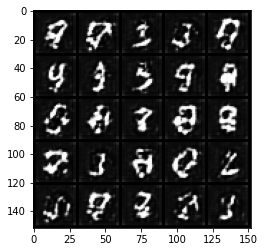

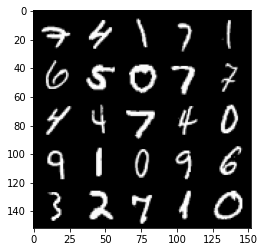

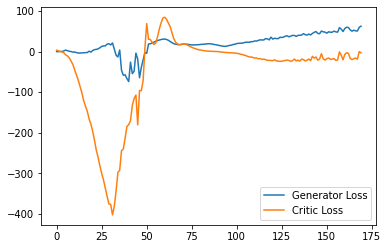

Step 3450: Generator loss: 60.195816650390626, critic loss: -4.149973838806152


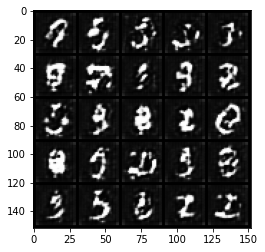

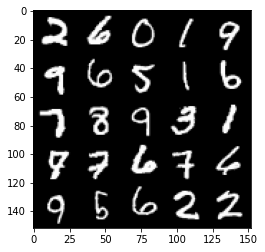

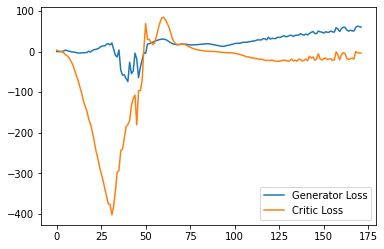

Step 3500: Generator loss: 51.21679893493652, critic loss: -18.576220731735226


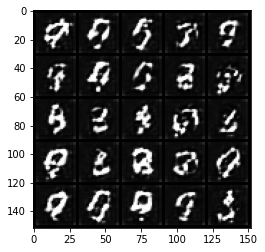

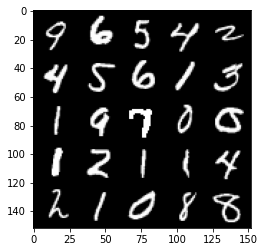

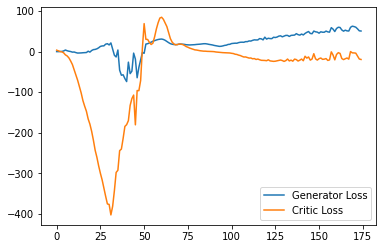

Step 3550: Generator loss: 53.839828948974606, critic loss: -18.291842688560482


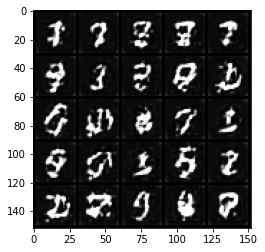

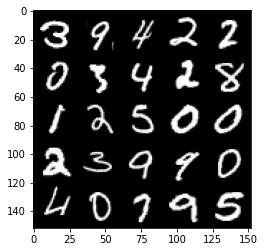

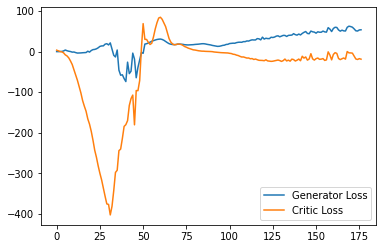

Step 3600: Generator loss: 51.46464256286621, critic loss: -20.149437915802004


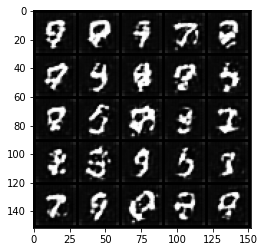

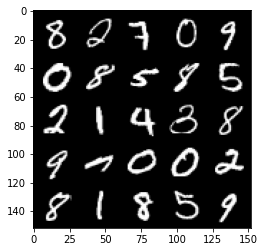

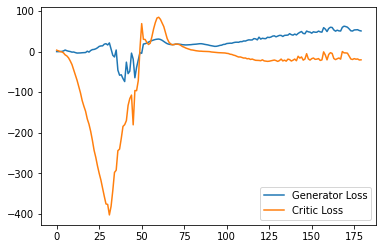

Step 3650: Generator loss: 58.43122566223145, critic loss: -8.58409813690185


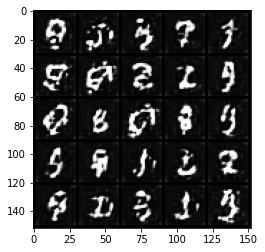

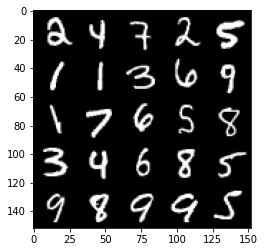

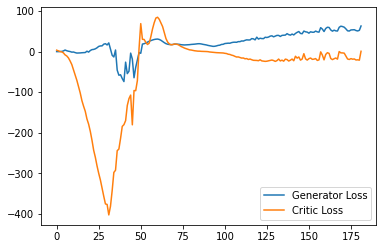

Step 3700: Generator loss: 53.33014839172363, critic loss: -13.39743274974823


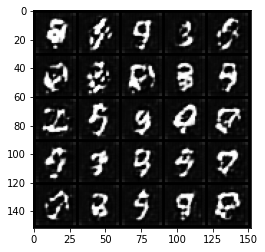

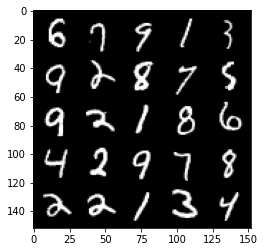

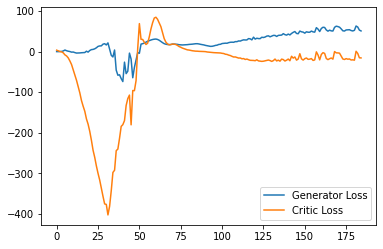

Step 3750: Generator loss: 53.18392112731934, critic loss: -15.441256689071658


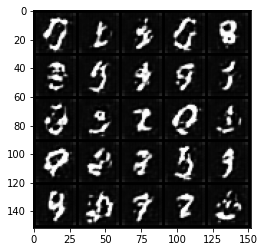

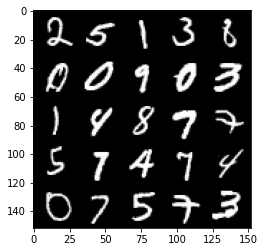

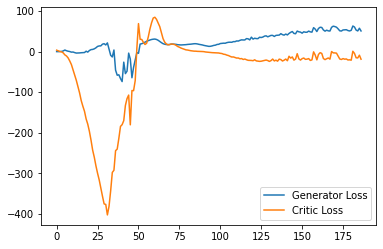

Step 3800: Generator loss: 53.360372390747074, critic loss: -13.111283687591555


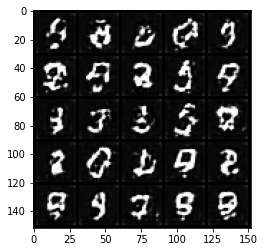

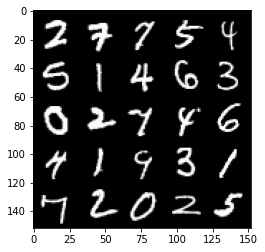

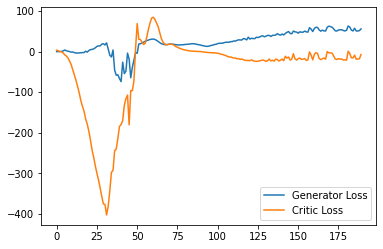

Step 3850: Generator loss: 53.904835891723636, critic loss: -15.231747696876525


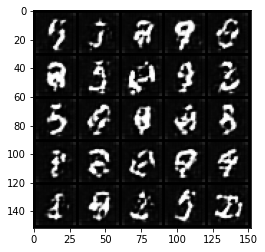

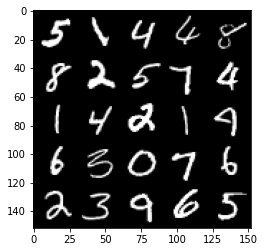

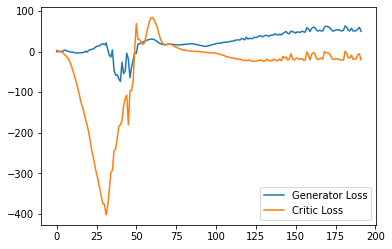

Step 3900: Generator loss: 54.34593460083008, critic loss: -16.221484465599055


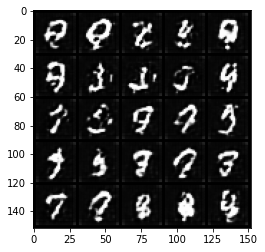

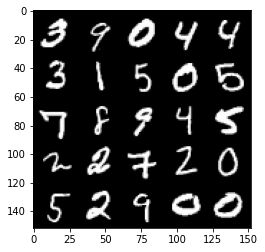

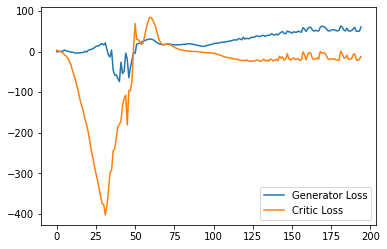

Step 3950: Generator loss: 57.275848712921146, critic loss: -7.008846372604366


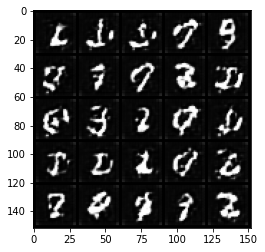

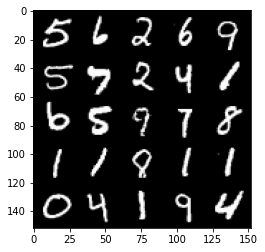

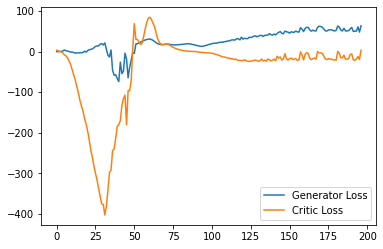

Step 4000: Generator loss: 59.69088676452637, critic loss: -3.5278876914978023


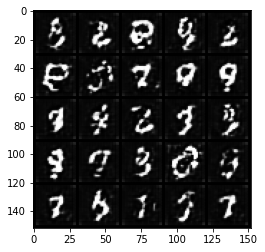

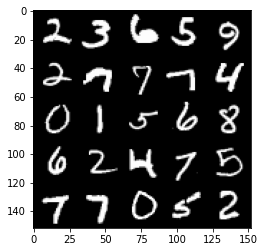

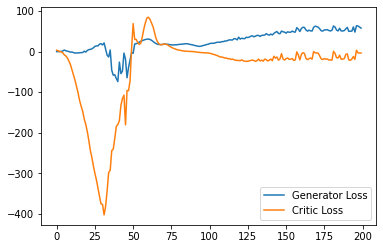

Step 4050: Generator loss: 52.35489456176758, critic loss: -14.625152720451354


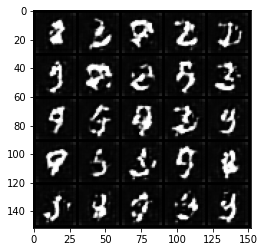

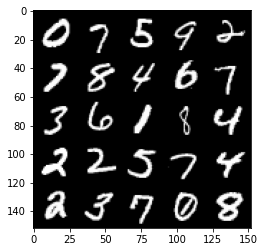

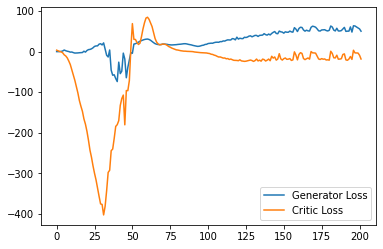

Step 4100: Generator loss: 53.13604972839355, critic loss: -11.95141464138031


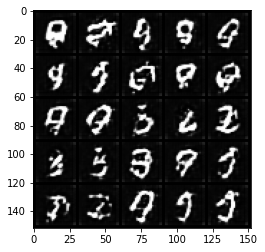

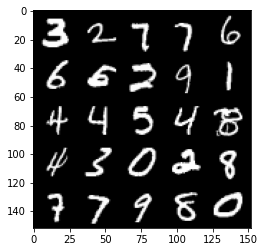

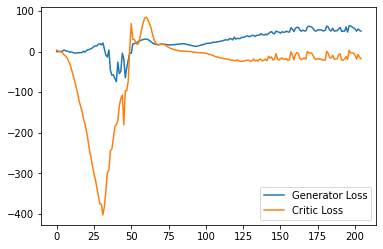

Step 4150: Generator loss: 52.47135543823242, critic loss: -18.06755984306336


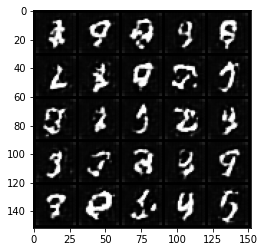

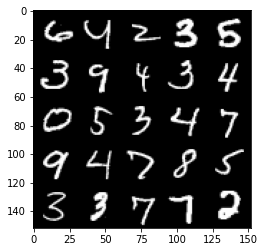

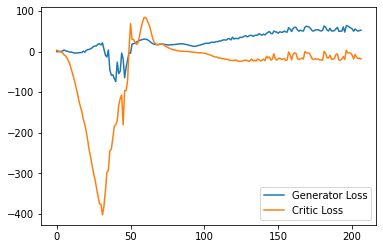

Step 4200: Generator loss: 61.488690490722654, critic loss: -3.5536490674018877


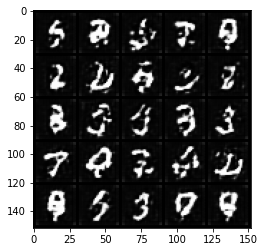

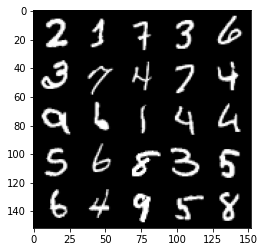

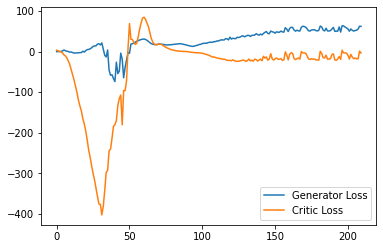

Step 4250: Generator loss: 55.44262336730957, critic loss: -10.46989000415802


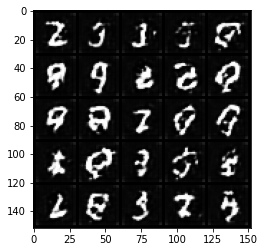

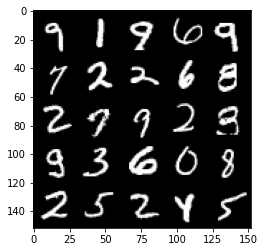

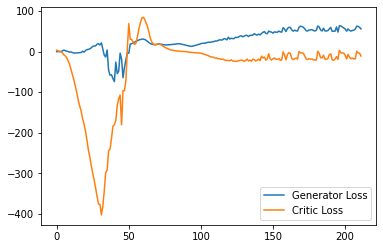

Step 4300: Generator loss: 53.29285789489746, critic loss: -16.811852991580963


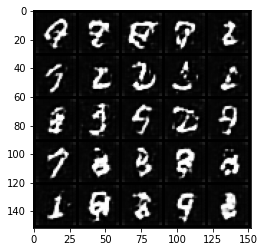

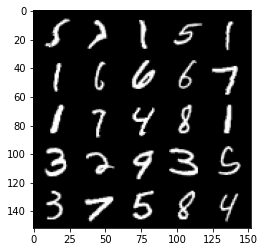

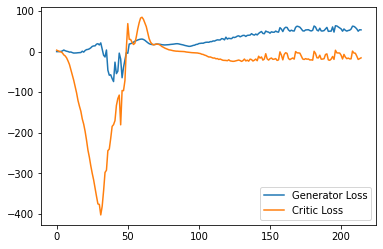

Step 4350: Generator loss: 53.26858856201172, critic loss: -18.624097893714904


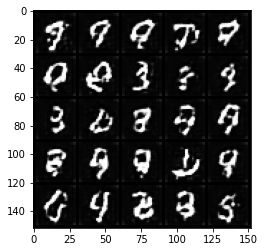

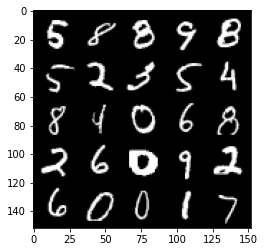

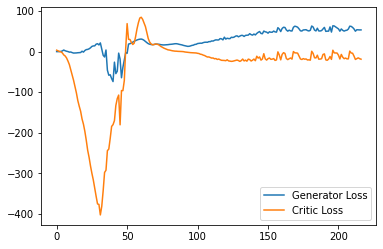

Step 4400: Generator loss: 54.626036148071286, critic loss: -18.653984130859374


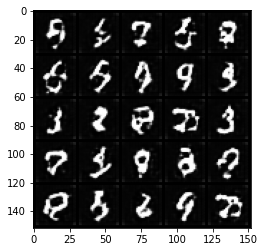

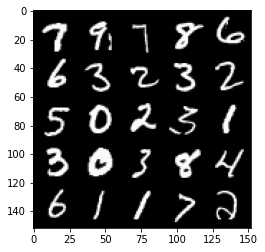

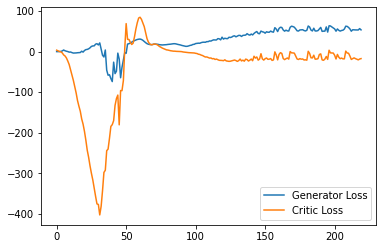

Step 4450: Generator loss: 60.18458732604981, critic loss: -5.27752043056488


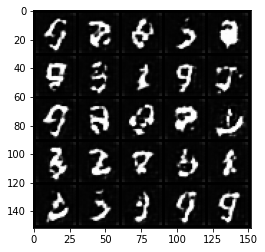

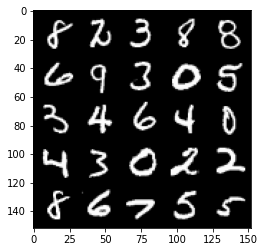

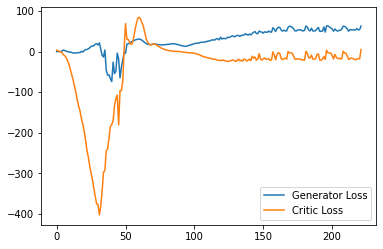

Step 4500: Generator loss: 63.23221397399902, critic loss: -3.257614841461182


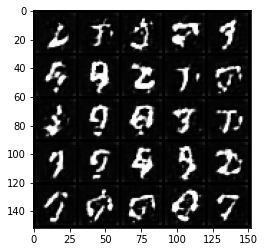

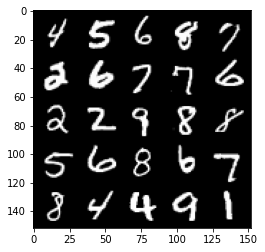

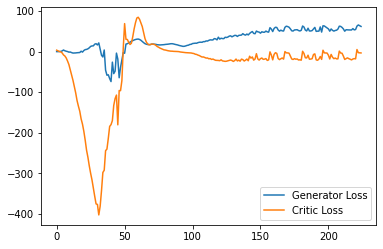

Step 4550: Generator loss: 59.809075927734376, critic loss: -3.599853722572326


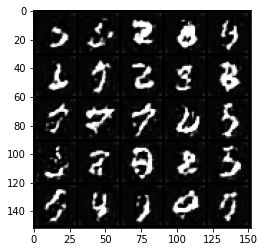

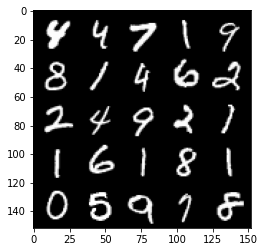

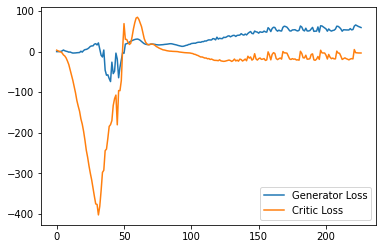

Step 4600: Generator loss: 61.08668167114258, critic loss: -4.861350208759308


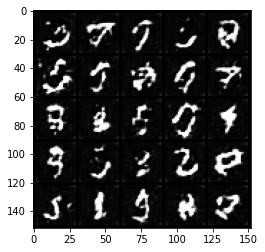

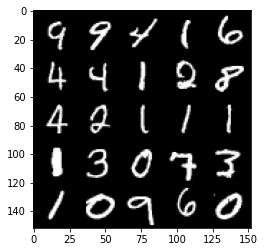

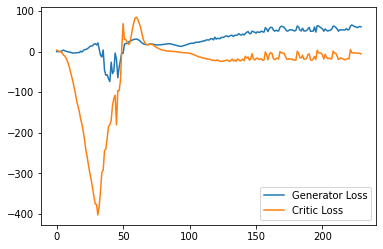

Step 4650: Generator loss: 57.74599082946777, critic loss: -14.040910066127779


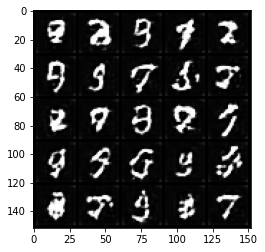

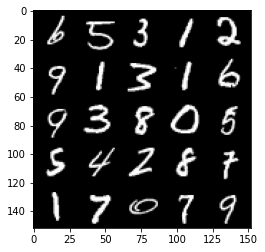

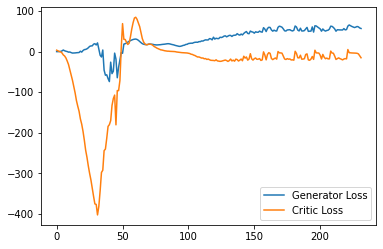

Step 4700: Generator loss: 58.32945251464844, critic loss: -12.745041318893435


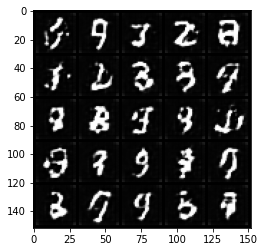

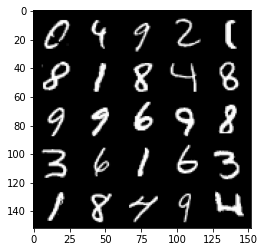

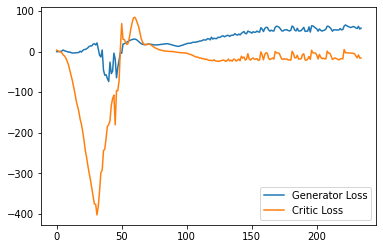

Step 4750: Generator loss: 59.790027084350584, critic loss: -15.833144843101504


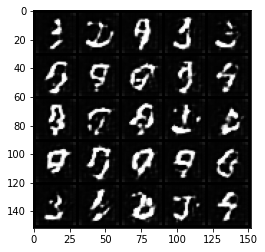

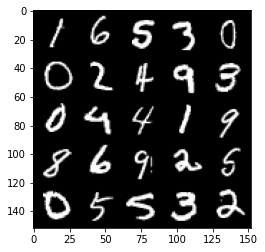

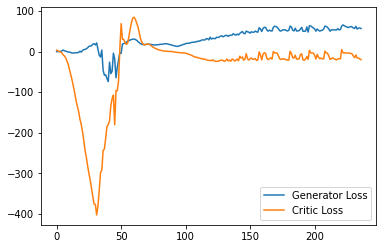

Step 4800: Generator loss: 59.88555824279785, critic loss: -16.693450034141538


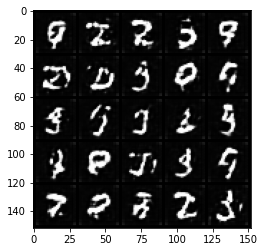

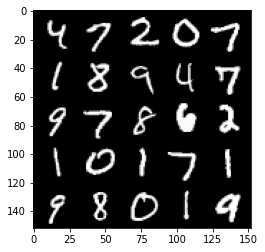

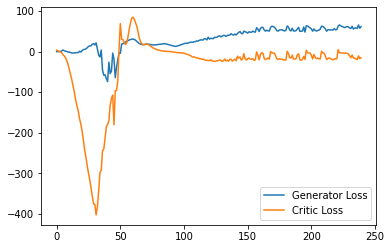

Step 4850: Generator loss: 64.88897094726562, critic loss: 0.5939322032928466


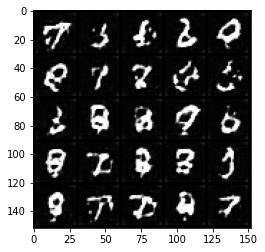

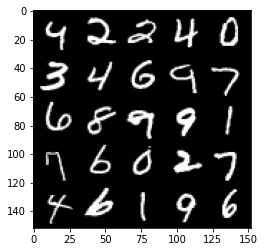

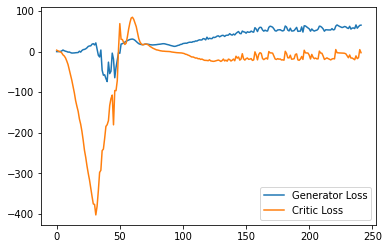

Step 4900: Generator loss: 65.09475326538086, critic loss: -2.7628298449516295


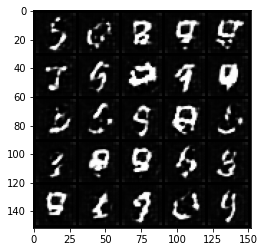

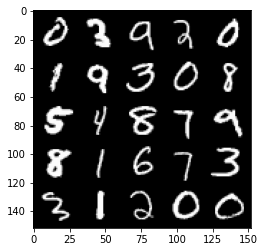

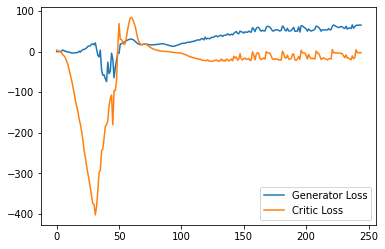

Step 4950: Generator loss: 65.09449111938477, critic loss: -3.093293440818787


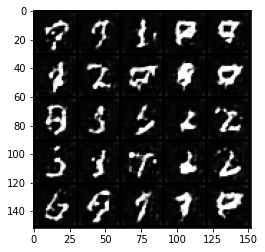

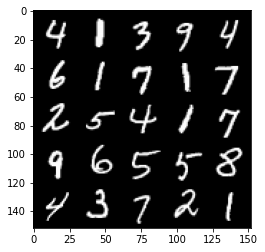

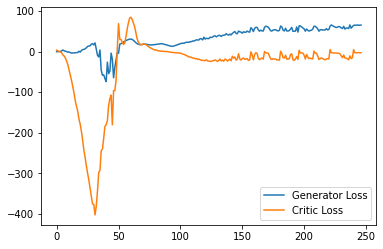

Step 5000: Generator loss: 65.6505354309082, critic loss: -3.641369863510133


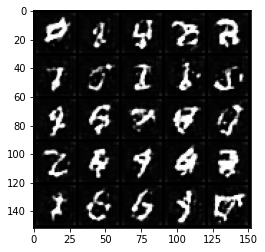

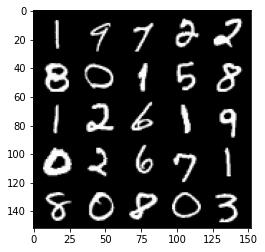

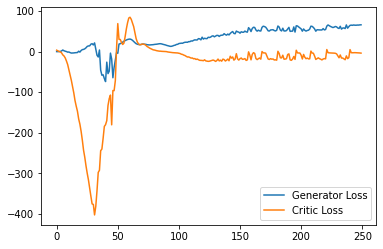

Step 5050: Generator loss: 62.60100006103516, critic loss: -7.375137622833251


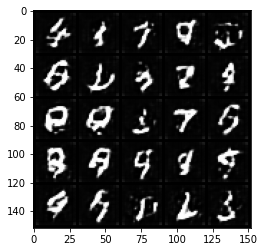

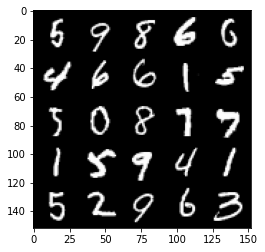

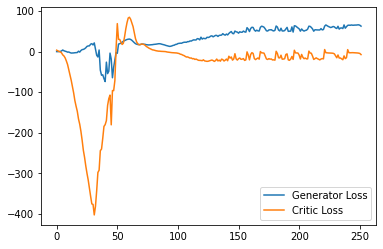

Step 5100: Generator loss: 60.3924210357666, critic loss: -14.366828462600706


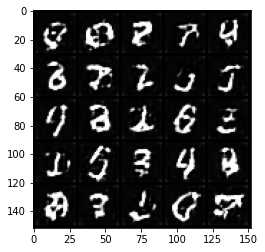

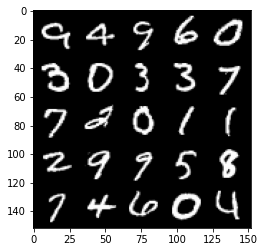

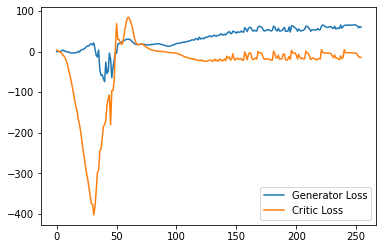

Step 5150: Generator loss: 58.69997261047363, critic loss: -17.878536107540132


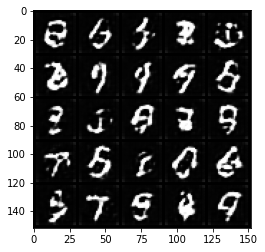

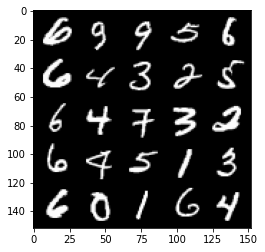

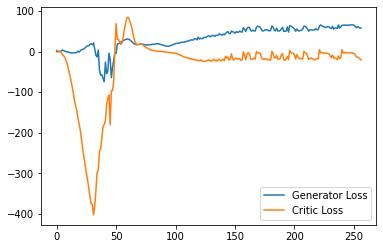

Step 5200: Generator loss: 59.46530921936035, critic loss: -18.055954732418062


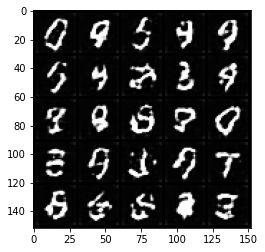

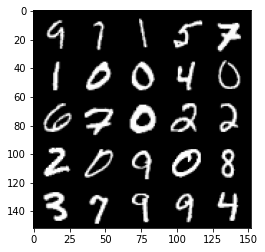

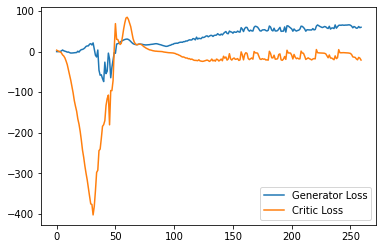

Step 5250: Generator loss: 61.038228607177736, critic loss: -20.865917497634886


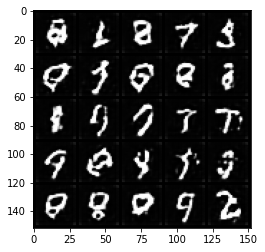

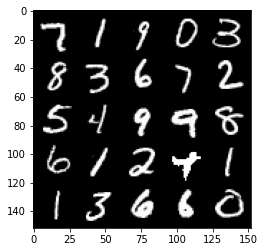

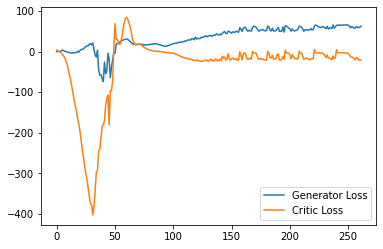

Step 5300: Generator loss: 66.490523147583, critic loss: -10.40611424922943


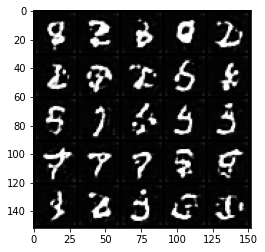

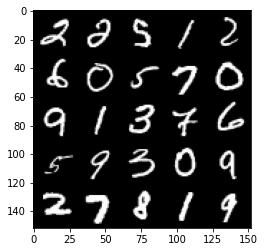

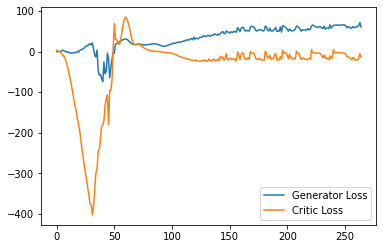

Step 5350: Generator loss: 63.355992736816404, critic loss: -15.764601263523103


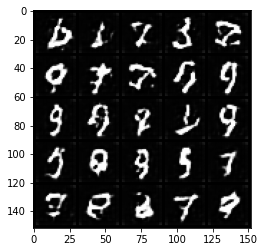

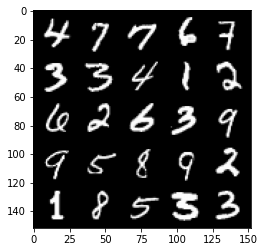

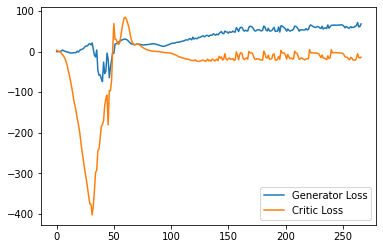

Step 5400: Generator loss: 58.46159790039062, critic loss: -18.042224169254304


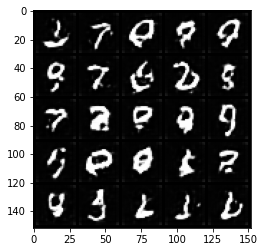

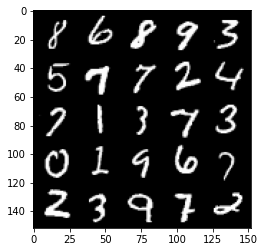

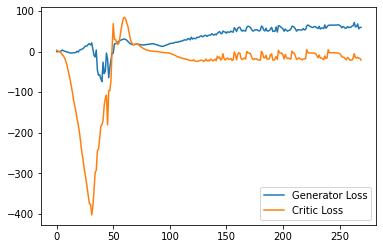

Step 5450: Generator loss: 70.65079483032227, critic loss: 1.6350720477104175


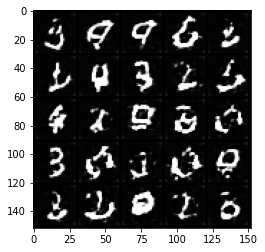

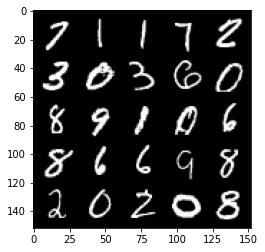

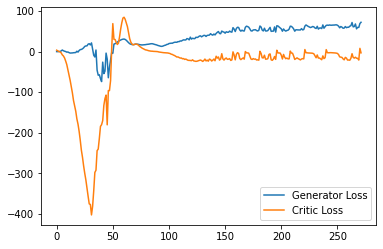

Step 5500: Generator loss: 67.71850372314454, critic loss: -2.95543873500824


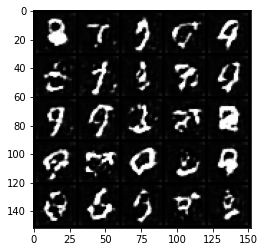

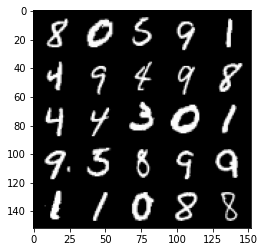

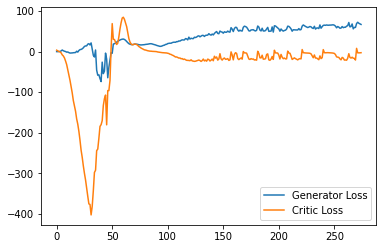

Step 5550: Generator loss: 67.3888153076172, critic loss: -3.6281389017105115


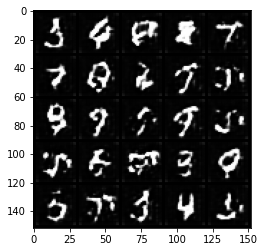

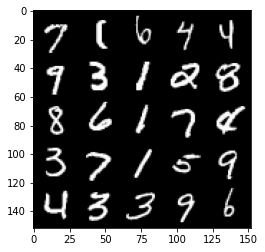

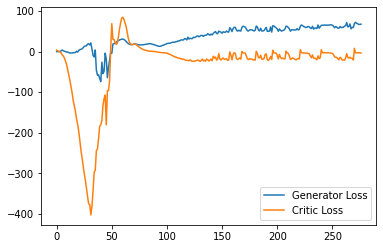

Step 5600: Generator loss: 63.18531532287598, critic loss: -11.737063322067259


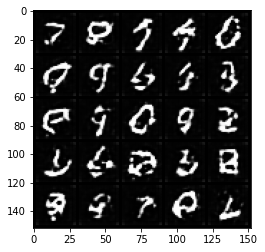

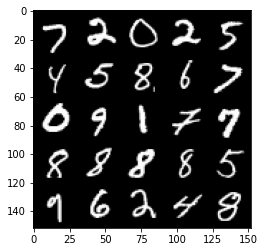

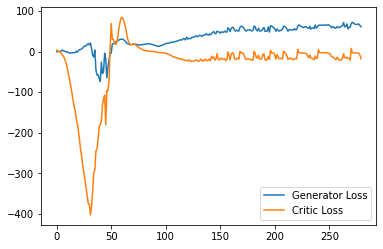

Step 5650: Generator loss: 64.84074577331543, critic loss: -13.810841524600981


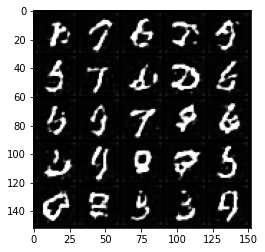

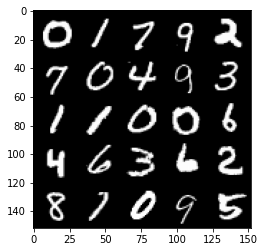

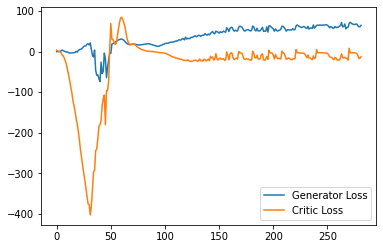

Step 5700: Generator loss: 61.70549827575684, critic loss: -18.167754991054533


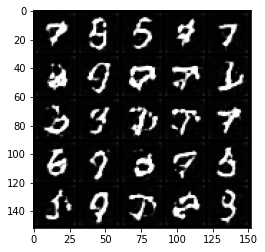

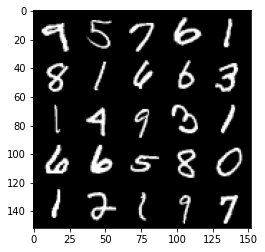

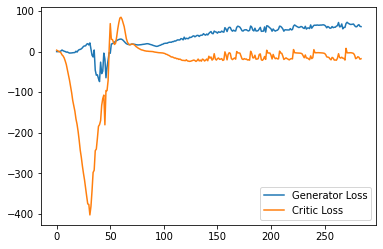

Step 5750: Generator loss: 65.75855010986328, critic loss: -16.35793262434006


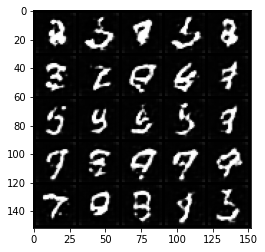

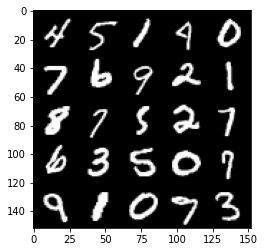

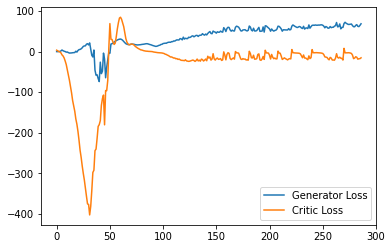

Step 5800: Generator loss: 66.32434837341309, critic loss: -18.995162594795236


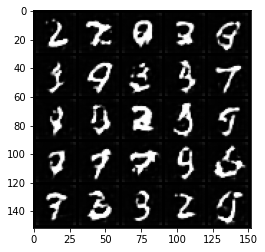

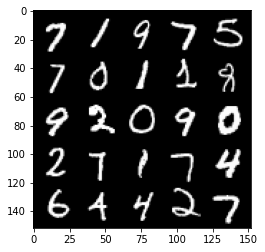

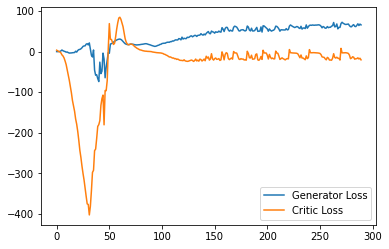

Step 5850: Generator loss: 68.95904373168945, critic loss: -14.188933062791829


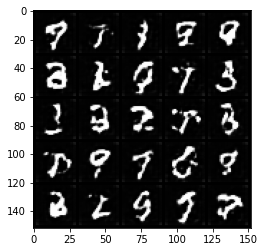

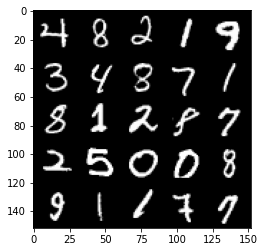

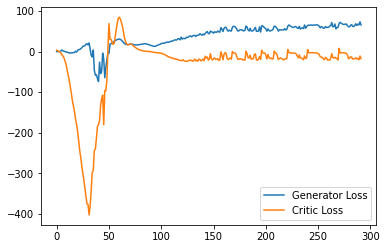

Step 5900: Generator loss: 69.9012133026123, critic loss: -18.103327463626865


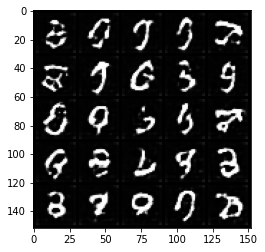

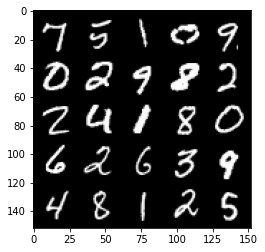

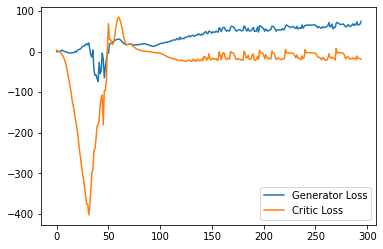

Step 5950: Generator loss: 70.43821327209473, critic loss: -7.786199400901799


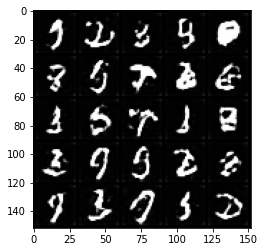

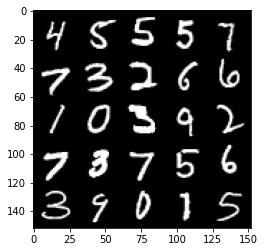

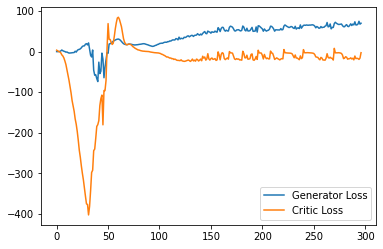

Step 6000: Generator loss: 77.22710479736328, critic loss: -4.359737829208374


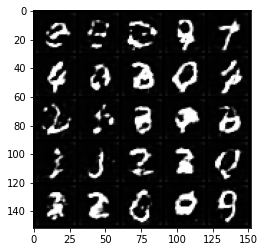

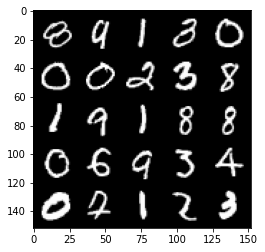

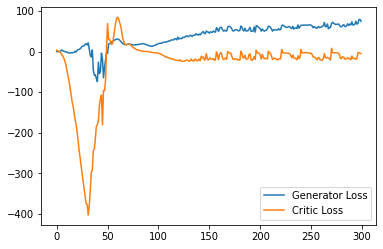

Step 6050: Generator loss: 69.50902389526367, critic loss: -11.679487470626832


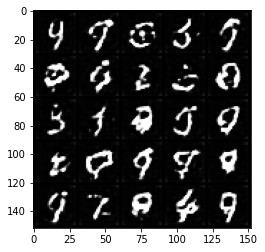

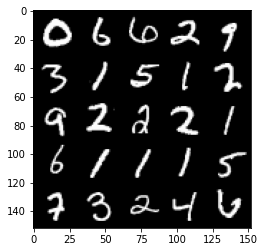

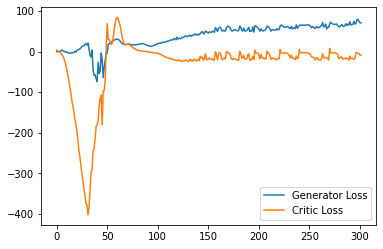

Step 6100: Generator loss: 67.78061172485351, critic loss: -16.995309715747837


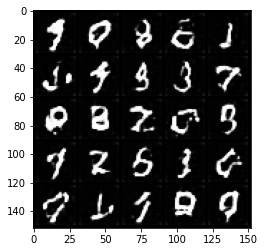

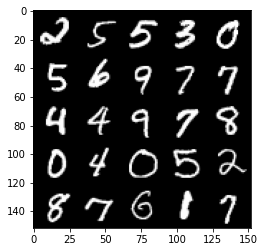

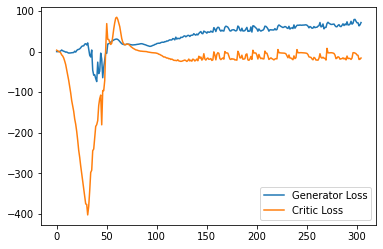

Step 6150: Generator loss: 71.20533432006836, critic loss: -11.7481231803894


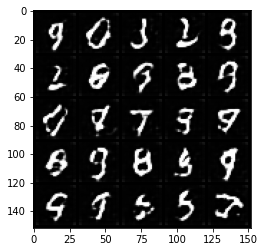

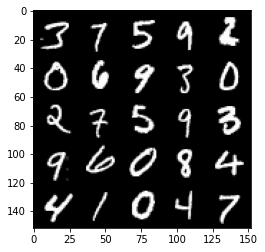

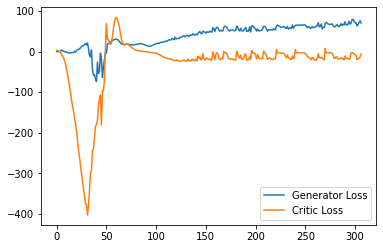

Step 6200: Generator loss: 73.26754127502441, critic loss: -13.9931448225975


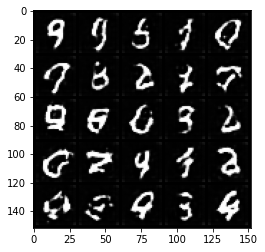

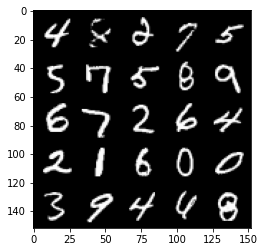

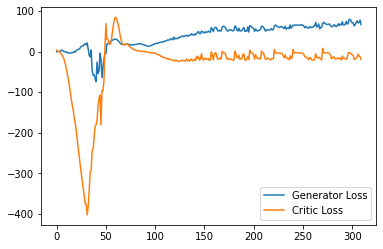

Step 6250: Generator loss: 76.05886741638183, critic loss: -14.748664175987246


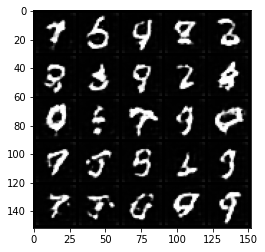

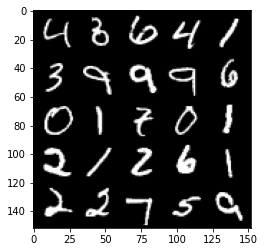

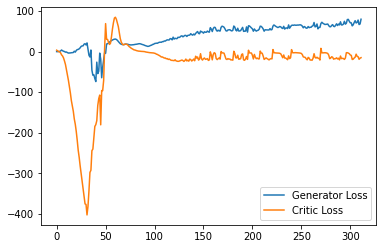

Step 6300: Generator loss: 71.94795783996582, critic loss: -16.829391285896303


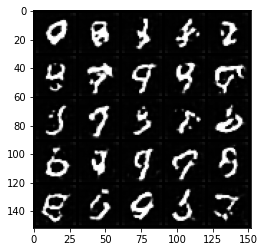

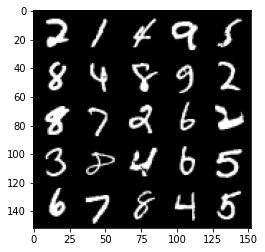

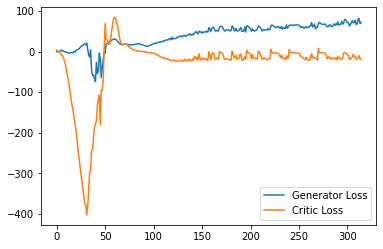

Step 6350: Generator loss: 74.7810408782959, critic loss: -17.03500611281395


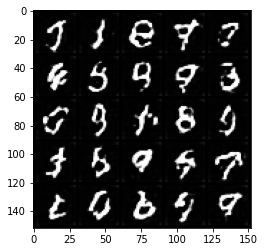

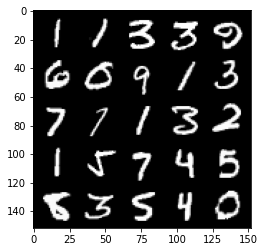

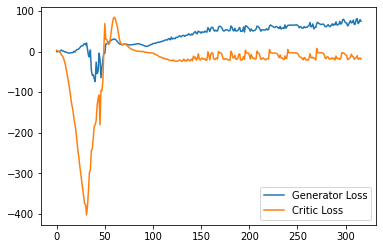

Step 6400: Generator loss: 72.473814163208, critic loss: -20.05546184182167


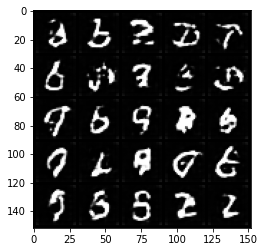

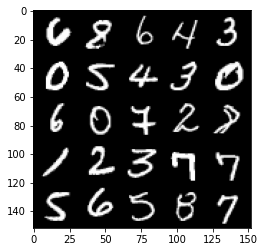

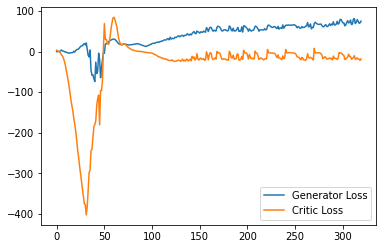

Step 6450: Generator loss: 72.46946922302246, critic loss: -13.104232423782351


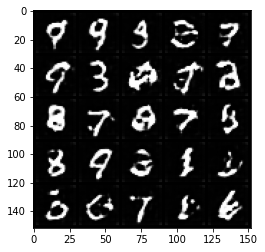

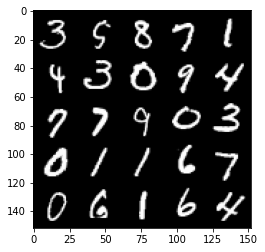

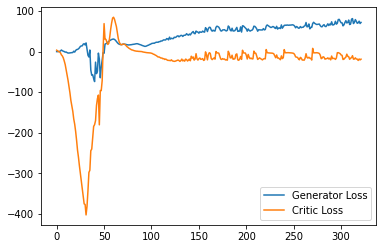

Step 6500: Generator loss: 72.40872978210449, critic loss: -13.829773448467257


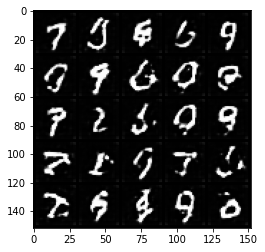

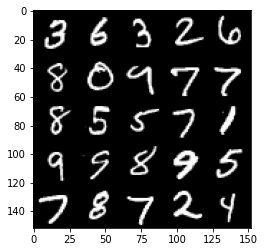

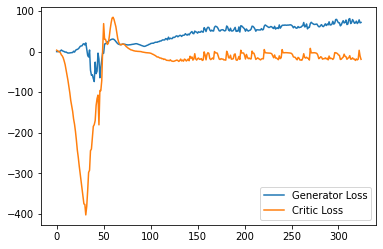

Step 6550: Generator loss: 77.49815986633301, critic loss: -16.396606983661655


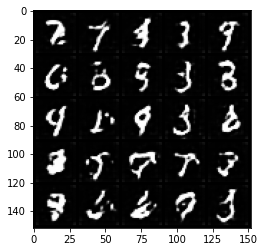

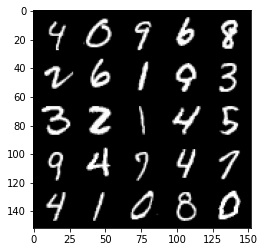

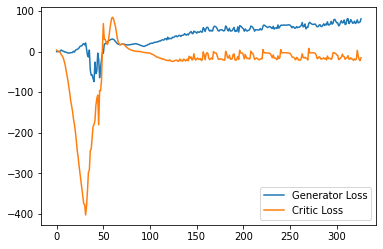

Step 6600: Generator loss: 76.86854400634766, critic loss: -15.920456278324128


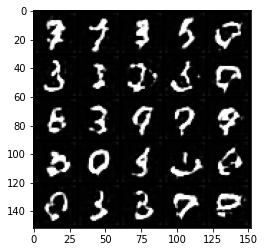

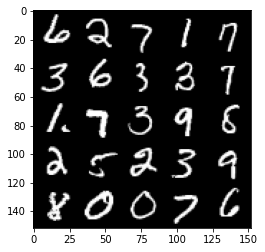

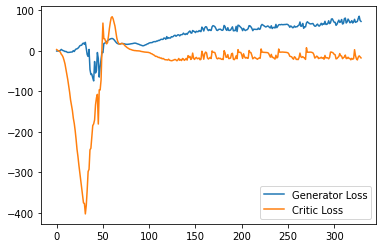

Step 6650: Generator loss: 81.0286646270752, critic loss: -12.82966647052765


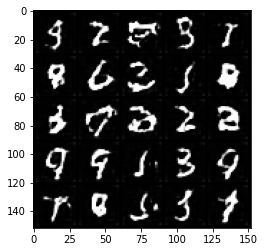

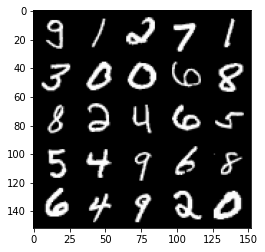

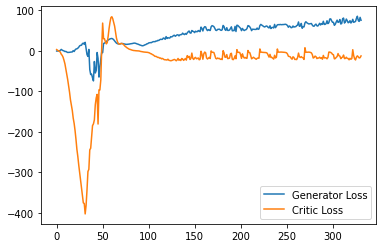

Step 6700: Generator loss: 77.11379486083985, critic loss: -15.685082181453707


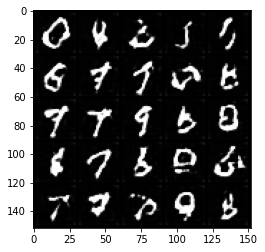

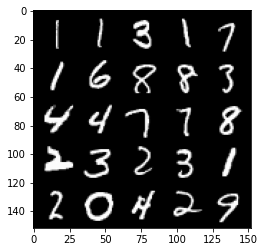

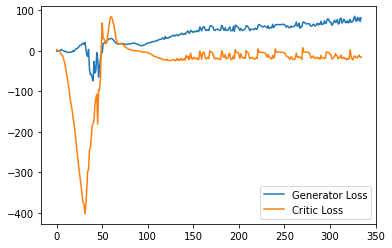

Step 6750: Generator loss: 78.0420361328125, critic loss: -6.645936867237092


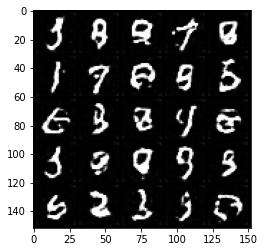

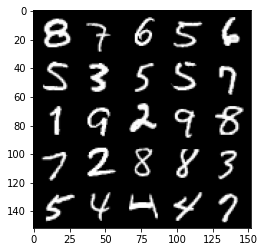

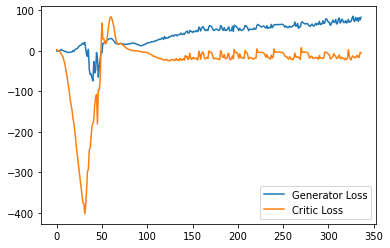

Step 6800: Generator loss: 74.7960922241211, critic loss: -16.489617436647418


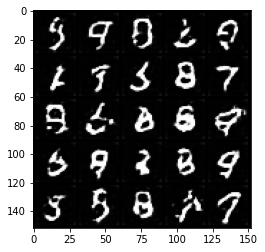

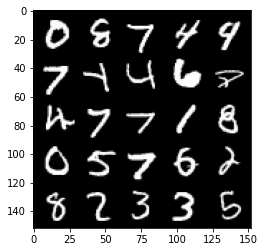

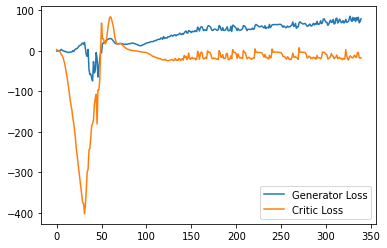

Step 6850: Generator loss: 82.95280059814453, critic loss: -16.049719562530516


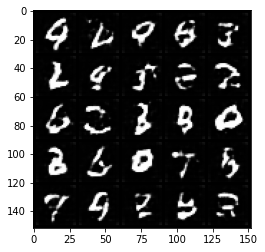

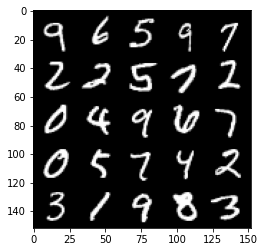

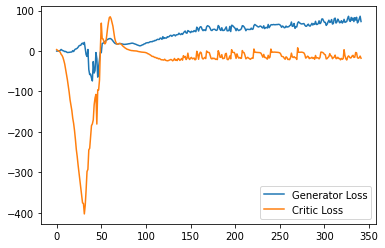

Step 6900: Generator loss: 75.51422927856446, critic loss: -17.78569508266449


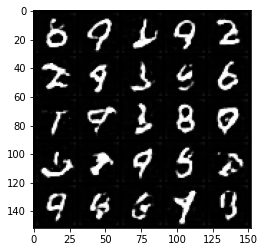

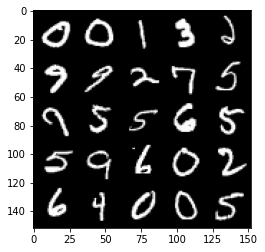

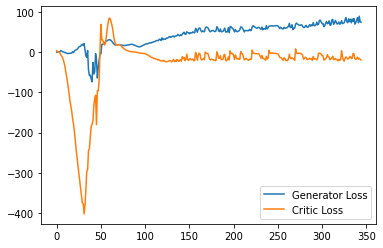

Step 6950: Generator loss: 85.4883969116211, critic loss: -14.227595079421999


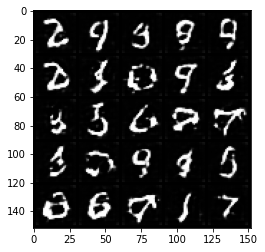

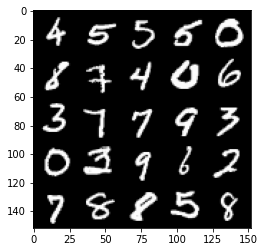

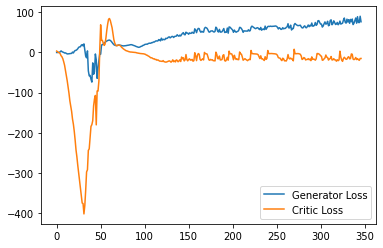

Step 7000: Generator loss: 80.37530242919922, critic loss: -17.727130374431614


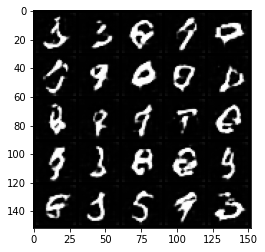

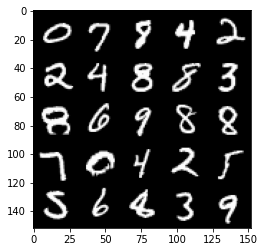

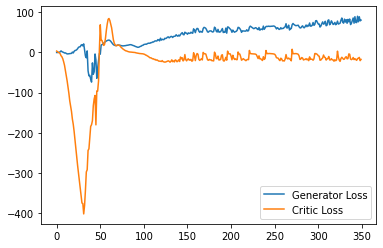

Step 7050: Generator loss: 76.41968681335449, critic loss: -10.83455615282059


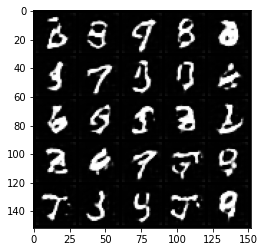

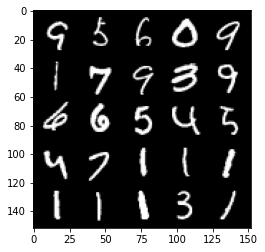

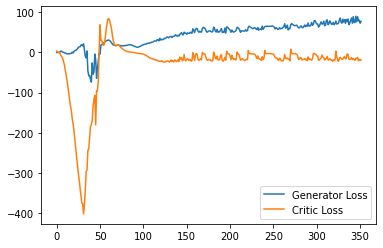

Step 7100: Generator loss: 79.00233680725097, critic loss: -11.463549384593964


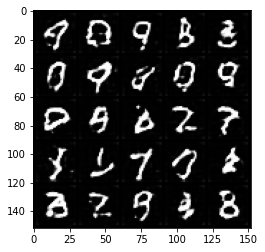

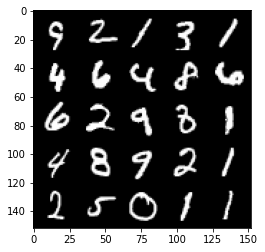

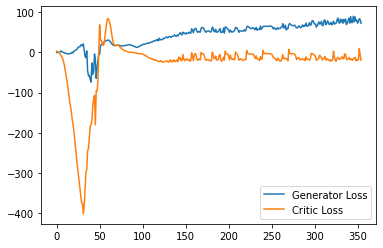

Step 7150: Generator loss: 76.29926361083984, critic loss: -20.368383574247353


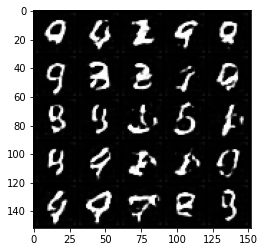

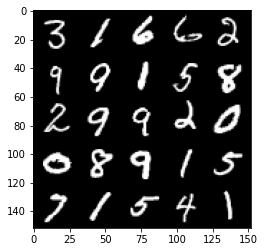

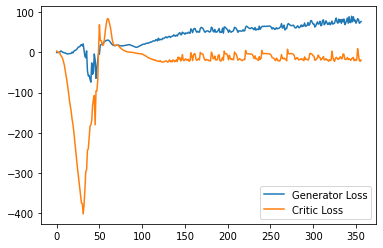

Step 7200: Generator loss: 81.37658508300781, critic loss: -19.787634497642518


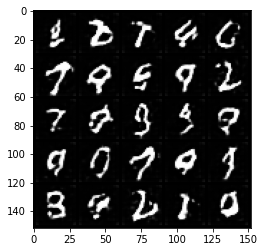

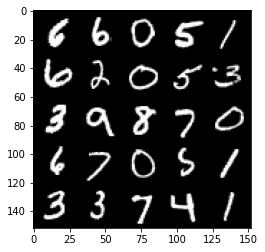

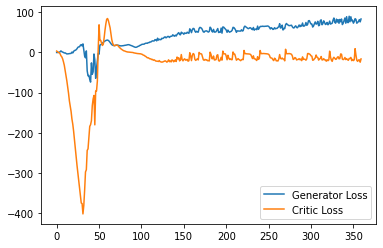

Step 7250: Generator loss: 84.8761946105957, critic loss: -15.150474545478824


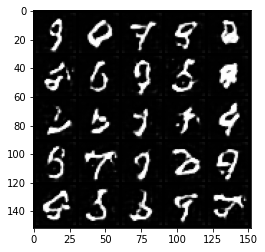

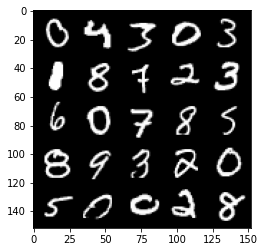

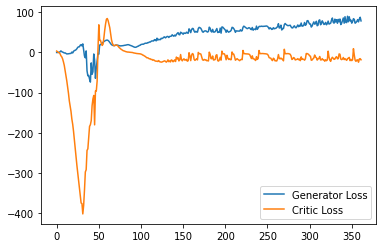

Step 7300: Generator loss: 80.85448509216309, critic loss: -17.505087896823888


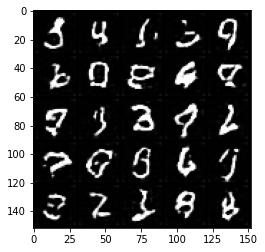

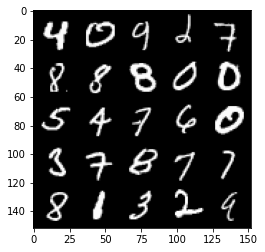

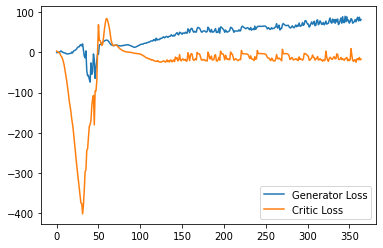

Step 7350: Generator loss: 75.73915313720703, critic loss: -18.700853500843053


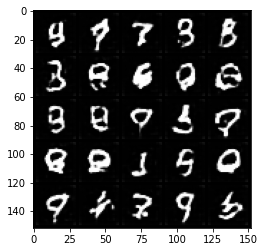

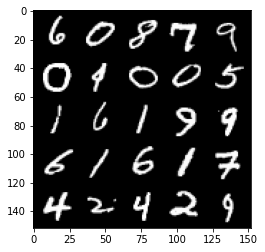

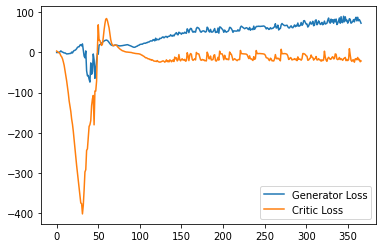

Step 7400: Generator loss: 81.40886672973633, critic loss: -16.5093121175766


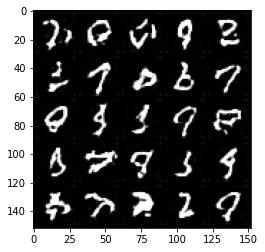

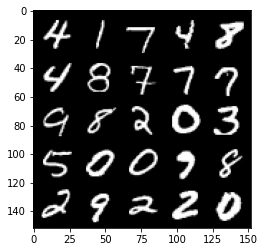

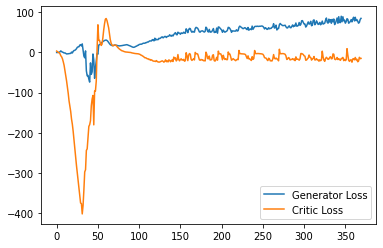

Step 7450: Generator loss: 83.8945118713379, critic loss: -13.277127145528798


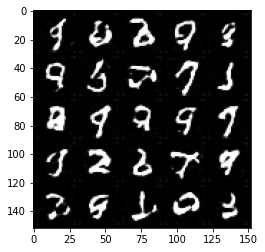

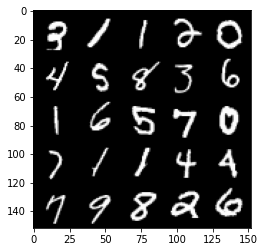

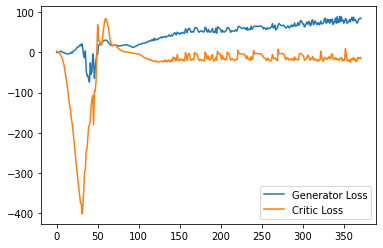

Step 7500: Generator loss: 79.7221794128418, critic loss: -18.783942795515067


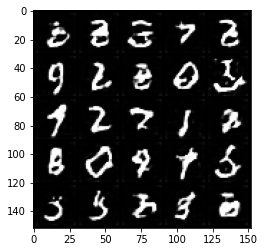

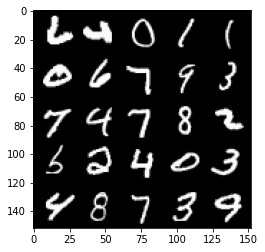

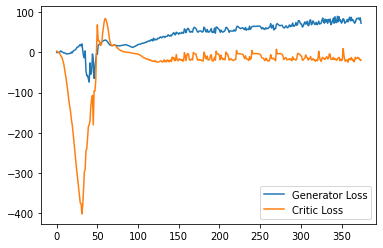

Step 7550: Generator loss: 79.1602767944336, critic loss: -18.46806755447388


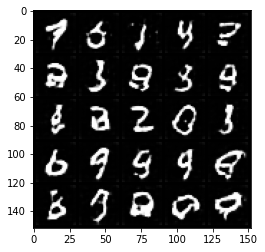

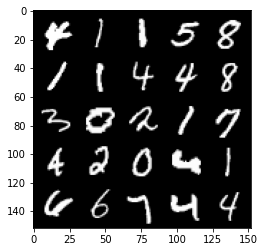

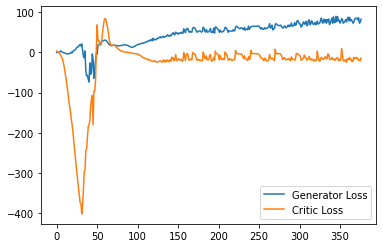

Step 7600: Generator loss: 85.09567733764648, critic loss: -8.359301404476161


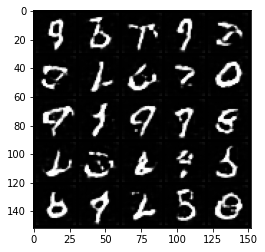

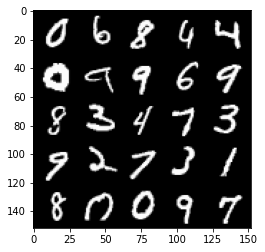

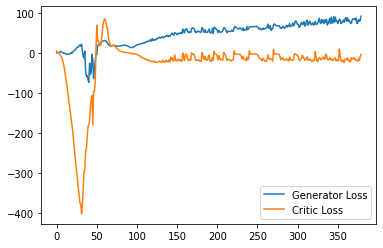

Step 7650: Generator loss: 82.51649421691894, critic loss: -11.570417229175568


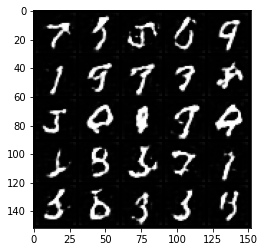

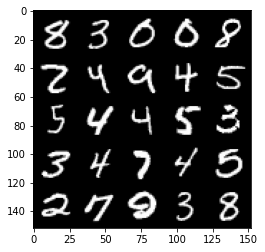

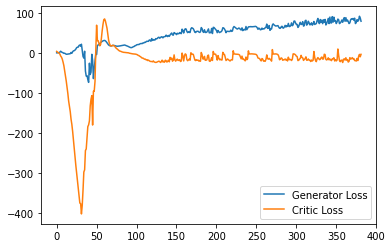

Step 7700: Generator loss: 85.73778717041016, critic loss: -13.297263511180875


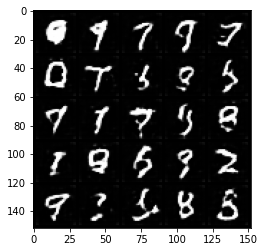

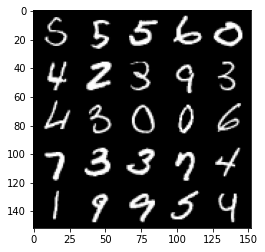

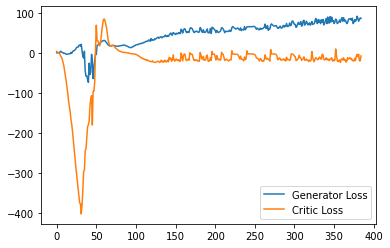

Step 7750: Generator loss: 82.13040695190429, critic loss: -10.38434468078613


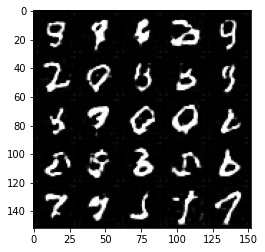

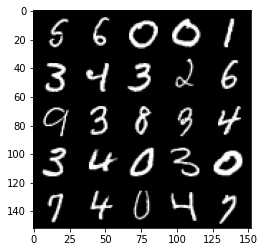

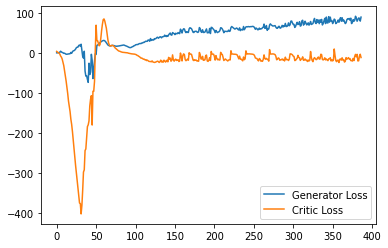

Step 7800: Generator loss: 78.68592819213868, critic loss: -19.662391924858092


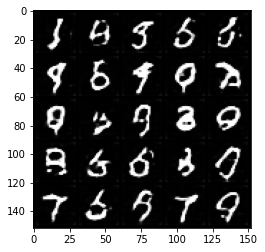

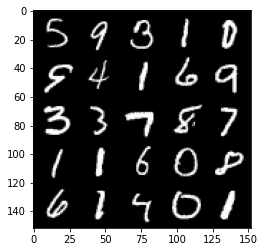

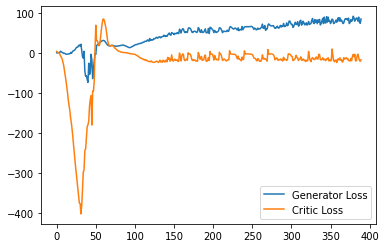

Step 7850: Generator loss: 89.27988891601562, critic loss: -16.42865339446068


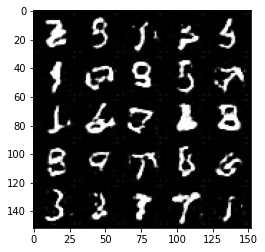

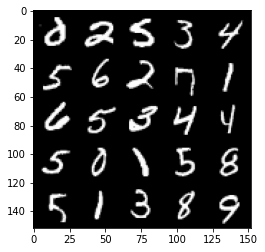

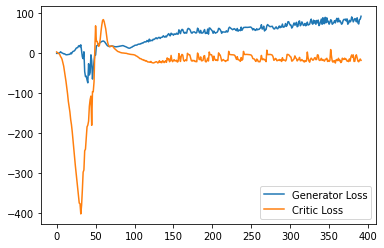

Step 7900: Generator loss: 84.38710723876953, critic loss: -13.77063090610504


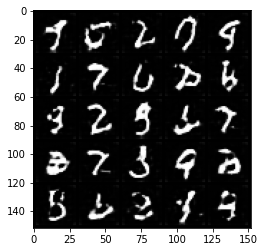

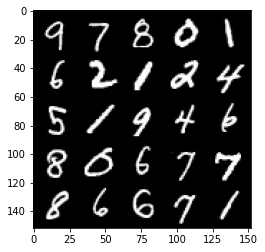

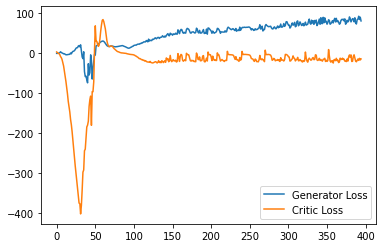

Step 7950: Generator loss: 82.53300277709961, critic loss: -15.960179685592655


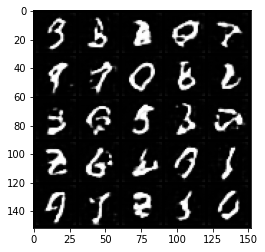

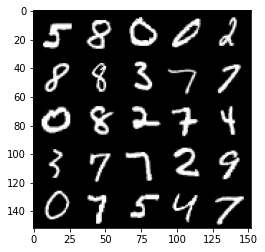

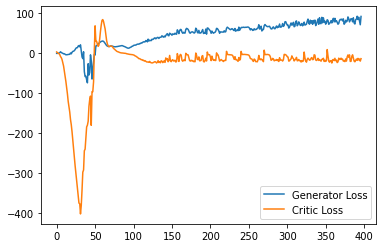

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
